In [1]:
# define logging and working directory
from ProjectRoot import change_wd_to_project_root
change_wd_to_project_root()
from src.utils.notebook_imports import *
from pyforest import *
from src.utils.Tensorflow_helper import choose_gpu_by_id
from tensorflow.keras.utils import plot_model

# define GPU id to use
GPU_IDS = '0,1'
GPUS = choose_gpu_by_id(GPU_IDS)
print(GPUS)

# jupyter magic config
%matplotlib inline
%reload_ext autoreload
%autoreload 2

# import helpers
from src.utils.utils_io import Console_and_file_logger, init_config
from src.visualization.Visualize import show_2D_or_3D
from src.data.Dataset import get_img_msk_files_from_split_dir, load_acdc_files, get_train_data_from_df, get_trainings_files
from src.data.Generators import DataGenerator, get_samples
#from src.utils.unet_3d_metrics import weighted_dice_coefficient_loss
from src.utils.KerasCallbacks import get_callbacks
import src.utils.my_metrics as metr
import cv2
from tensorflow.keras.losses import mse
import src.utils.my_metrics as metr


# define experiment name for report, model and log paths + filenames
#EXPERIMENT = '2D/tf2/acdc/combined/2D_NOrot90_dfsplit_6_224_11_fold1'
EXPERIMENT = '3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean'
now = datetime.datetime.now()
# image params, change for different input data/architecture
ARCHITECTURE = '3D' # 2D
# path params
DATASET = 'GCN'  # 'acdc' # or 'gcn'
TRAIN_PATH = 'data/raw/{}/{}/train/'.format(DATASET, ARCHITECTURE)
VAL_PATH = 'data/raw/{}/{}/val/'.format(DATASET, ARCHITECTURE)
TEST_PATH = 'data/raw/{}/{}/val/'.format(DATASET, ARCHITECTURE)
#DF_DATA_PATH = 'data/raw/{}/{}/df_kfold.csv'.format(DATASET, ARCHITECTURE)
#DF_DATA_PATH = 'data/raw/miccai2020/2d_dataset.csv' # miccai special case
DATA_PATH = '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/'
FOLD = 0

MODEL_PATH = os.path.join('models', EXPERIMENT, str(now.strftime("%Y-%m-%d_%H_%M")))
TENSORBOARD_LOG_DIR = os.path.join('reports/tensorboard_logs', EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))
CONFIG_PATH = os.path.join('reports/configs/',EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))
HISTORY_PATH = os.path.join('reports/history/',EXPERIMENT,str(now.strftime("%Y-%m-%d_%H_%M")))

DIM = [32,64, 64] # network input params for spacing of 5
#DIM = [80, 224, 224]
DEPTH = 4 # number of down-/upsampling blocks
FILTERS = 32 # initial number of filters, will be doubled after each downsampling block
#SPACING = [8,1.1, 1,1] # used by sitk, order will be reversed to have the same shape as dim
SPACING = [5,5, 5] # if resample, resample to this spacing
M_POOL = [2, 2, 2]# used for downsampling and upsampling
F_SIZE = [3, 3, 3] # conv filter size
IMG_CHANNELS = 1
MASK_VALUES = [0, 1, 2, 3]  #channel order: Background, RV, MYO, LV
MASK_CLASSES = len(MASK_VALUES) # no of labels
BORDER_MODE = cv2.BORDER_REFLECT_101
IMG_INTERPOLATION = cv2.INTER_LINEAR
MSK_INTERPOLATION = cv2.INTER_NEAREST
AUGMENT = False
SHUFFLE = True
AUGMENT_GRID = False
RESAMPLE = True
SCALER = 'MinMax' # MinMax Standard or Robust

# training params
#GENERATOR_WORKER = 6# if not set, use batchsize
SEED = 42 # define a seed for the generator shuffle
BATCHSIZE = 2 # 32, 64, 24, 16, 1 for 3D use: 8
INITIAL_EPOCH = 0 # change this to continue training
EPOCHS = 300 # define a maximum numbers of epochs
EPOCHS_BETWEEN_CHECKPOINTS = 5
MONITOR_FUNCTION = 'transformed_output_loss'
MONITOR_MODE = 'min'
SAVE_MODEL_FUNCTION = 'transformed_output_loss'
SAVE_MODEL_MODE = 'min'
BN_FIRST = False # decide if BN between Conv and activation or afterwards
BATCH_NORMALISATION = True # apply BN or not
USE_UPSAMPLE = True # otherwise use transpose
PAD = 'same' # padding strategy
KERNEL_INIT = 'he_normal' # conv weight initialisation
OPTIMIZER = 'adam' # Adam, Adagrad, RMSprop, Adadelta,  # https://keras.io/optimizers/
ACTIVATION = 'elu' # tf.keras.layers.LeakyReLU(), relu, any non linear activation function
LEARNING_RATE = 1e-4 # start with a huge lr to converge fast
DECAY_FACTOR = 0.3 # Define a learning rate decay for the ReduceLROnPlateau callback
MIN_LR = 1e-10 # smaller lr does not improve the model
DROPOUT_min = 0.3 # lower dropout at the shallow layers
DROPOUT_max = 0.5 # higher dropout at the deep layers

metrics = [
    metr.dice_coef_labels,
    metr.dice_coef_myo,
    metr.dice_coef_lv,
    metr.dice_coef_rv
]

#MASKING_VALUES = [2]
#MASKING_IMAGE = False

LOSS_FUNCTION = metr.bce_dice_loss
#LOSS_FUNCTION = metr.jaccard_distance_loss
#LOSS_FUNCTION = metr.bce_dice_jac_loss

Console_and_file_logger(EXPERIMENT, logging.INFO)

# Define a config for param injection,
# save a serialized version, 
# make sure all paths exist
config = init_config(config=locals(), save=True)
print(config)

search for root_dir and set working directory
Working directory set to: /mnt/data/git/cardio


Using TensorFlow backend.
2020-07-15 11:05:14,234 INFO -------------------- Start --------------------
2020-07-15 11:05:14,234 INFO Working directory: /mnt/data/git/cardio.
2020-07-15 11:05:14,235 INFO Log file: ./logs/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean.log
2020-07-15 11:05:14,235 INFO Log level for console: INFO


['/gpu:0', '/gpu:1']
{'GPU_IDS': '0,1', 'GPUS': ['/gpu:0', '/gpu:1'], 'EXPERIMENT': '3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean', 'ARCHITECTURE': '3D', 'DATASET': 'GCN', 'TRAIN_PATH': 'data/raw/GCN/3D/train/', 'VAL_PATH': 'data/raw/GCN/3D/val/', 'TEST_PATH': 'data/raw/GCN/3D/val/', 'DATA_PATH': '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/', 'FOLD': 0, 'MODEL_PATH': 'models/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05', 'TENSORBOARD_LOG_DIR': 'reports/tensorboard_logs/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05', 'CONFIG_PATH': 'reports/configs/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05', 'HISTORY_PATH': 'reports/history/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NO

In [2]:
# Load AX slices

from src.data.Generators import MotionDataGenerator, CycleMotionDataGenerator
info = {}

x_train_ax, y_train_ax, x_val_ax, y_val_ax =  get_trainings_files(data_path=DATA_PATH,fold=FOLD)
config.update(info)
config = init_config(config)

logging.info('x_train files: {}, y_train files: {}'.format(len(x_train_ax), len(y_train_ax)))
logging.info('x_val files: {}, y_val files: {}'.format(len(x_val_ax), len(y_val_ax)))

2020-07-15 11:05:14,264 INFO Found 162 images/masks in /mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/
2020-07-15 11:05:14,270 INFO Selected 120 of 162 files with 64 of 86 patients for training fold 0
2020-07-15 11:05:14,271 INFO x_train files: 120, y_train files: 120
2020-07-15 11:05:14,271 INFO x_val files: 42, y_val files: 42


In [3]:
# load SAX slices
DATA_PATH_SAX = DATA_PATH.replace('AX_3D_ISO', 'AX_to_SAX_3D_ISO_SHIFT')
#DATA_PATH_SAX = 'data/interim/sax_ax_3d_thres_50_max/ax_to_sax'
x_train_sax, y_train_sax, x_val_sax, y_val_sax =  get_trainings_files(data_path=DATA_PATH_SAX,fold=FOLD)
config.update(info)
config = init_config(config)

logging.info('x_train files: {}, y_train files: {}'.format(len(x_train_sax), len(y_train_sax)))
logging.info('x_val files: {}, y_val files: {}'.format(len(x_val_sax), len(y_val_sax)))

2020-07-15 11:05:14,295 INFO Found 162 images/masks in /mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_to_SAX_3D_ISO_SHIFT/
2020-07-15 11:05:14,302 INFO Selected 120 of 162 files with 64 of 86 patients for training fold 0
2020-07-15 11:05:14,303 INFO x_train files: 120, y_train files: 120
2020-07-15 11:05:14,304 INFO x_val files: 42, y_val files: 42


In [4]:
print('ax examples: {}'.format(x_train_ax[:2]))
print('sax_examples: {}'.format(x_train_sax[:2]))

ax examples: ['/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/0000-0PTV75MP_2005-06-27_ED_img.nrrd', '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/0000-0PTV75MP_2005-06-27_ES_img.nrrd']
sax_examples: ['/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_to_SAX_3D_ISO_SHIFT/0000-0PTV75MP_2005-06-27_ED_img.nrrd', '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_to_SAX_3D_ISO_SHIFT/0000-0PTV75MP_2005-06-27_ES_img.nrrd']


In [5]:
# filter files by name
#x_train_ax = [x for x in x_train_ax if 'CT8YR38C_2005' in x]
print(len(x_train_ax))
#x_train_sax = [x for x in x_train_sax if 'CT8YR38C_2005' in x]

120


In [6]:
Console_and_file_logger('temp', logging.INFO)
# config['BATCHSIZE'] = 32 # debug
batch_generator = MotionDataGenerator(x_train_ax, x_train_sax, config)
valid_config = config.copy()
valid_config['AUGMENT_GRID'] = False
valid_generator = MotionDataGenerator(x_val_ax, x_val_sax, valid_config)

2020-07-15 11:05:14,363 INFO -------------------- Start --------------------
2020-07-15 11:05:14,363 INFO Working directory: /mnt/data/git/cardio.
2020-07-15 11:05:14,363 INFO Log file: ./logs/temp.log
2020-07-15 11:05:14,364 INFO Log level for console: INFO
2020-07-15 11:05:14,364 INFO Create DataGenerator
2020-07-15 11:05:14,365 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 2
 Scaler: MinMax
 Images: 120 
 Augment_grid: False 
 Thread workers: 2
2020-07-15 11:05:14,365 INFO No augmentation
2020-07-15 11:05:14,365 INFO Create DataGenerator
2020-07-15 11:05:14,366 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 2
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 2
2020-07-15 11:05:14,366 INFO No augmentation


In [7]:
# Select batch generator output
x = ''
y = ''
@interact
def select_batch(batch = (0,len(batch_generator), 1)):
    global x, y, ax
    input_ , output_ = batch_generator.__getitem__(batch)
    x = input_[0]
    y = output_[0]
    #ax = output_[1]
    logging.info(x.shape)
    logging.info(y.shape)
    #logging.info(ax.shape)

interactive(children=(IntSlider(value=30, description='batch', max=60), Output()), _dom_classes=('widget-inter…

In [8]:
@interact
def select_image_in_batch(im = (0,x.shape[0]- 1, 1),slice_by=(1,6)):
    
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.DEBUG)
    #show_2D_or_3D(x[im][...,0][::5])
    logging.info('AX: {}'.format(x[im].shape))
    show_2D_or_3D(x[im][...,0][::slice_by])
    plt.savefig('reports/images/temp/ax.pdf')
    plt.show()
    logging.info('AXtoSAX: {}'.format(y[im].shape))
    show_2D_or_3D(y[im][...,0][::slice_by])
    plt.savefig('reports/images/temp/sax.pdf')
    plt.show()
    """logging.info('AXtoSAXtoAX: {}'.format(ax[im].shape))
    show_2D_or_3D(ax[im][...,0][::slice_by])
    plt.savefig('reports/images/temp/sax.pdf')
    plt.show()"""
    

interactive(children=(IntSlider(value=0, description='im', max=1), IntSlider(value=3, description='slice_by', …

In [9]:
"""temp = np.random.rand(10,20,20)
show_2D_or_3D(temp)
plt.show()
plt.hist(temp.ravel())
plt.show()
weights = np.linspace(100,0,temp.shape[0])
print(weights)
weighted = temp * weights[:,None,None]
show_2D_or_3D(weighted)
im = plt.show()
plt.hist(weighted.ravel())
plt.show()"""

'temp = np.random.rand(10,20,20)\nshow_2D_or_3D(temp)\nplt.show()\nplt.hist(temp.ravel())\nplt.show()\nweights = np.linspace(100,0,temp.shape[0])\nprint(weights)\nweighted = temp * weights[:,None,None]\nshow_2D_or_3D(weighted)\nim = plt.show()\nplt.hist(weighted.ravel())\nplt.show()'

In [11]:
import src.models.SpatialTransformer as st
from src.models.SpatialTransformer import create_affine_transformer, create_affine_cycle_transformer, create_affine_transformer_max_unet_predictions

In [12]:
if 'strategy' in globals():
    pass
else:
    # distribute the training with the mirrored data paradigm across multiple gpus if available, if not use gpu 0
    strategy = tf.distribute.MirroredStrategy(devices=config.get('GPUS', ["/gpu:0"]))
with strategy.scope():
    model = st.create_affine_transformer_max_unet_predictions(config=config, metrics=metrics, unet=unet)

Number of devices: 2
(None, 32, 64, 64, 1)


2020-07-14 17:08:51,843 WARNING From /home/sven/anaconda3/envs/tf2/lib/python3.6/site-packages/tensorflow/python/util/deprecation.py:574: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with dtype is deprecated and will be removed in a future version.
Instructions for updating:
Use fn_output_signature instead


In [14]:
model.summary()

Model: "affine_transformer"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 64, 64,  0                                            
__________________________________________________________________________________________________
conv3d (Conv3D)                 (None, 32, 64, 64, 3 896         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 64, 64, 3 128         conv3d[0][0]                     
__________________________________________________________________________________________________
dropout (Dropout)               (None, 32, 64, 64, 3 0           batch_normalization[0][0]        
_________________________________________________________________________________

In [15]:
plot_model(model, to_file='data/temp/graph.png',show_shapes=True)

In [13]:
@interact
def select_image_in_batch(im = (0,x.shape[0]- 1, 1),mask_smaller_than='0.01', slice_by=(1,6)):
    global m
    temp = x[im]
    temp_ = y[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on: {}'.format(temp.shape))
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    pred, m, msk = model.predict(np.expand_dims(temp,axis=0))                     
    logging.info('rotated by the model: {}'.format(pred[0].shape))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('msk by the model: {}'.format(msk[0].shape))
    show_2D_or_3D(msk[0][::slice_by])
    plt.show()
    logging.info('prob greater 0.9: {}'.format(metr.max_volume_loss()(msk,msk)))
    temp_max = tf.reduce_max(msk[0],axis=-1).numpy()
    show_2D_or_3D(temp_max[::slice_by])
    plt.show()
    logging.info('uncertain areas 0.9: {}'.format(metr.max_volume_loss()(msk,msk)))
    uncertain = tf.reduce_max(msk[0][...,1:],axis=-1).numpy()> 0.5
    show_2D_or_3D(uncertain[::slice_by])
    plt.show()
    
    # calculate the loss mask from target AX2SAX image
    mask = temp_ >float(mask_smaller_than)
    logging.info('masked by GT: {}'.format(mask.shape))
    masked = pred[0] * mask
    show_2D_or_3D(masked[::slice_by], mask[::slice_by])
    plt.show()
    logging.info('target (SAX): {}'.format(temp_.shape))
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    logging.info('MSE: {}'.format(mse(pred[0], temp_).numpy().mean()))
    #logging.info('MSE center cube: {}'.format(metr.cubic_center_loss_wrapper(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

interactive(children=(IntSlider(value=0, description='im', max=1), Text(value='0.01', description='mask_smalle…

In [32]:
# second trainings step, 
# finetune the model with the first n slices to enforce the z translation 
# and crop each slice by a margin to ignore the big error of the black edges due to the rotation focus on the image itself
from src.models.Unets import get_optimizer
model.compile(optimizer=get_optimizer(config, 'finetune'),loss={'transformed_output': metr.loss_with_margin(z_margin=-10,inplane_margin=20), 'affine_matrix':None},loss_weights={'transformed_output': 1.0, 'affine_matrix':None })

In [33]:
# train one model
initial_epoch = 0
# training

# start a new main process for this training to free gpu memory afterwards
logging.info('Fit model, start trainings process')
# fit model with trainingsgenerator
results = model.fit(
    x=batch_generator,
    validation_data=valid_generator,
    validation_steps=len(valid_generator),
    epochs=200,
    callbacks = get_callbacks(config),
    steps_per_epoch = len(batch_generator),
    initial_epoch=initial_epoch,
    max_queue_size=6,
    workers=8,
    #use_multiprocessing=True,
    verbose=1)

2020-07-15 12:41:53,430 INFO Fit model, start trainings process


Epoch 1/200


2020-07-15 12:42:12,592 INFO batch_all_reduce: 46 all-reduces with algorithm = nccl, num_packs = 1
2020-07-15 12:42:26,396 INFO batch_all_reduce: 46 all-reduces with algorithm = nccl, num_packs = 1


 1/60 [..............................] - ETA: 0s - loss: 0.0747 - transformed_output_loss: 0.0747

2020-07-15 12:42:34,111 WARNING From /home/sven/anaconda3/envs/tf2/lib/python3.6/site-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.


 2/60 [>.............................] - ETA: 4s - loss: 0.0674 - transformed_output_loss: 0.0674

2020-07-15 12:42:34,226 WARNING Callbacks method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0400s vs `on_train_batch_end` time: 0.1200s). Check your callbacks.


60/60 [==============================] - ETA: 0s - loss: 0.0700 - transformed_output_loss: 0.0700

2020-07-15 12:43:05,153 INFO Saved model to disk: models/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05



Epoch 00001: transformed_output_loss improved from inf to 0.06995, saving model to models/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05/checkpoint.h5
60/60 [==============================] - 31s 524ms/step - loss: 0.0700 - transformed_output_loss: 0.0700 - val_loss: 0.0698 - val_transformed_output_loss: 0.0698 - lr: 1.0000e-04
Epoch 2/200
60/60 [==============================] - ETA: 0s - loss: 0.0687 - transformed_output_loss: 0.0687
Epoch 00002: transformed_output_loss improved from 0.06995 to 0.06867, saving model to models/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-15_11_05/checkpoint.h5
60/60 [==============================] - 21s 344ms/step - loss: 0.0687 - transformed_output_loss: 0.0687 - val_loss: 0.0810 - val_transformed_output_loss: 0.0810 - lr: 1.0000e-04
Epoch 3/200
60/60 [==============================] - ETA: 0s - loss: 0.0719 - trans

KeyboardInterrupt: 

In [9]:
# load pre-trained AXtoSAX rotation model

"""
load past config for model training 
"""
if tf.distribute.has_strategy():
    strategy = tf.distribute.get_strategy()
else:
    # distribute the training with the mirrored data paradigm across multiple gpus if available, if not use gpu 0
    strategy = tf.distribute.MirroredStrategy(devices=config.get('GPUS', ["/gpu:0"]))
tf.print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
# trained on the full volume, finetuned on firt 20 slices with a margin of 50 (cube mse loss), start looks good, some mistakes are still there
config_file  = 'reports/configs/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-14_17_07/config.json'
load = True # change to false, if this pipeline is used without finetuning
# load config with all params into global namespace
from src.models.Unets import load_pretrained_model
if load: # load pretrained model
    with open(config_file, encoding='utf-8') as data_file:
        config_temp = json.loads(data_file.read())
    config_temp['LOSS_FUNCTION'] = config['LOSS_FUNCTION']
    logging.info('Load model from Experiment: {}'.format(config_temp['EXPERIMENT']))
    #logging.info('config:\n {}'.format(json.dumps(config, indent=4, sort_keys=True)))

    try:
        with strategy.scope():
            globals()['model'] = load_pretrained_model(config_temp, metrics, comp=False,multigpu=False, transformer=True)
            #model.summary()
    except Exception as e:
        logging.error(str(e))

2020-07-15 11:05:36,679 INFO Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0', '/job:localhost/replica:0/task:0/device:GPU:1')


Number of devices: 2


2020-07-15 11:05:36,682 INFO Load model from Experiment: 3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean
2020-07-15 11:05:36,683 INFO loading model from: models/3D/ax_sax/register_ax_to_sax/temp_concat_avg_flatten_2dense_thres_07_1_NOgridaugment_lossthresh_mean/2020-07-14_17_07/model.json .


using tensorflow, need to monkey patch
tf.python.backend.slice overwritten by monkey patch


2020-07-15 11:05:37,165 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,168 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,199 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,202 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,223 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,226 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:0 then broadcast to ('/job:localhost/replica:0/task:0/device:CPU:0',).
2020-07-15 11:05:37,254 INFO Reduce to /job:localhost/replica:0/task:0/device:CPU:

# Fast predictions with all files of the generator

In [34]:
from src.utils.my_metrics import loss_with_margin as cube_loss
cfg = config.copy()
cfg['BATCHSIZE'] = 10
cfg['AUGMENT_GRID'] = False
valid_generator = MotionDataGenerator(x_train_ax, x_train_sax, cfg)
input_, output_ = valid_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
@interact
def select_image_in_batch(im = (0,x_.shape[0]- 1, 1), slice_by=(1,6)):
    global m
    temp = x_[im]
    temp_ = y_[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on:')
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    logging.info('rotated by the model')
    pred, m,_ = model.predict(np.expand_dims(temp,axis=0))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('target (SAX):')
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    """logging.info('inverted rotation')
    show_2D_or_3D(inv[0][::slice_by])
    plt.show()"""
    z_margin = -10
    inplane_margin = 20
    y_true = temp_
    y_pred = pred[0]
    y_true = y_true[:z_margin, inplane_margin: -inplane_margin, inplane_margin:-inplane_margin,:]
    y_pred = y_pred[:z_margin, inplane_margin: -inplane_margin, inplane_margin:-inplane_margin,:]
    logging.info('pred:')
    show_2D_or_3D(y_pred)
    plt.show()
    logging.info('gt:')
    show_2D_or_3D(y_true)
    plt.show()
    
    print(y_true.shape)
    print(y_pred.shape)
    print('MSE: {}'.format(mse(temp_, pred[0]).numpy().mean()))
    print('MSE center cube: {}'.format(cube_loss(z_margin=-20,inplane_margin=20)(temp_, pred[0]).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

2020-07-15 13:08:40,672 INFO Create DataGenerator
2020-07-15 13:08:40,673 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 10
 Scaler: MinMax
 Images: 120 
 Augment_grid: False 
 Thread workers: 10
2020-07-15 13:08:40,674 INFO No augmentation


interactive(children=(IntSlider(value=4, description='im', max=9), IntSlider(value=3, description='slice_by', …

# Predictions on the heldout test split

In [16]:
cfg = config.copy()
cfg['BATCHSIZE'] = len(x_val_ax)
v_generator = MotionDataGenerator(x_val_ax, x_val_sax, cfg)
input_, output_ = v_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
@interact
def select_image_in_batch(im = (0,x_.shape[0]- 1, 1), slice_by=(1,6)):
    global m
    temp = x_[im]
    temp_ = y_[im]
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('prediction on:')
    show_2D_or_3D(temp[::slice_by])
    plt.show()
    logging.info('rotated by the model')
    pred, m, _ = model.predict(np.expand_dims(temp,axis=0))
    show_2D_or_3D(pred[0][::slice_by])
    plt.show()
    logging.info('target (SAX):')
    show_2D_or_3D(temp_[::slice_by])
    plt.show()
    print('MSE: {}'.format(mse(pred[0], temp_).numpy().mean()))
    #print('MSE center cube: {}'.format(metr.cubic_center_loss_wrapper(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0],(3,4)))
    except Exception as e:
        pass

2020-07-14 17:56:11,154 INFO Create DataGenerator
2020-07-14 17:56:11,155 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-07-14 17:56:11,156 INFO No augmentation


interactive(children=(IntSlider(value=20, description='im', max=41), IntSlider(value=3, description='slice_by'…

## 1. AX and SAX volumes 

Create a MotionDatagenerator from the heldout test split without shuffle and batchsize == len(files)

## 2. AX images and AX masks

Create a Datagenerator from AX image and mask files, both will be used in the next cell for the prediction pipeline

In [22]:
config

{'GPU_IDS': '0,1',
 'GPUS': ['/gpu:0', '/gpu:1'],
 'EXPERIMENT': '3D/ax_sax/register_ax_to_sax/concat_avg_flatten_2dense_thres_07_1_NOgridaugmentlossthresh',
 'ARCHITECTURE': '3D',
 'DATASET': 'GCN',
 'TRAIN_PATH': 'data/raw/GCN/3D/train/',
 'VAL_PATH': 'data/raw/GCN/3D/val/',
 'TEST_PATH': 'data/raw/GCN/3D/val/',
 'DATA_PATH': '/mnt/data/git/cardio/data/raw/gcn_05_2020_ax_sax_86/AX_3D_ISO/',
 'FOLD': 0,
 'MODEL_PATH': 'models/3D/ax_sax/register_ax_to_sax/concat_avg_flatten_2dense_thres_07_1_NOgridaugmentlossthresh/2020-07-13_21_49',
 'TENSORBOARD_LOG_DIR': 'reports/tensorboard_logs/3D/ax_sax/register_ax_to_sax/concat_avg_flatten_2dense_thres_07_1_NOgridaugmentlossthresh/2020-07-13_21_49',
 'CONFIG_PATH': 'reports/configs/3D/ax_sax/register_ax_to_sax/concat_avg_flatten_2dense_thres_07_1_NOgridaugmentlossthresh/2020-07-13_21_49',
 'HISTORY_PATH': 'reports/history/3D/ax_sax/register_ax_to_sax/concat_avg_flatten_2dense_thres_07_1_NOgridaugmentlossthresh/2020-07-13_21_49',
 'DIM': [32, 64,

In [23]:
temp = np.random.rand(3,4)
print(temp)
temp_ = temp[:,3]
print(temp_)
temp_ = (temp_ *5)/1.5
temp_

[[0.26419023 0.26030209 0.77321728 0.3568337 ]
 [0.97087879 0.71310079 0.8775788  0.52358445]
 [0.09487832 0.87232405 0.82005271 0.93442447]]
[0.3568337  0.52358445 0.93442447]


array([1.18944566, 1.74528151, 3.11474823])

In [35]:
# create a motion generator from the val files without shuffle for sorted predictions
from src.models.SpatialTransformer import create_affine_transformer_fixed
from src.data.Preprocess import from_channel_to_flat, transform_to_binary_mask
from src.data.Postprocess import clean_3d_prediction_3d_cc
import shutil
from src.data.Dataset import copy_meta_and_save
cfg = config.copy()
cfg['BATCHSIZE'] = len(x_val_ax)
cfg['SHUFFLE'] = False
v_generator = MotionDataGenerator(x_val_ax, x_val_sax, cfg)
input_, output_ = v_generator.__getitem__(0)
x_ = input_[0]
y_ = output_[0]
msk_cfg = cfg.copy()
msk_cfg['IMG_CHANNELS'] = 1
msk_cfg['DIM'] = [80,224,224]
msk_cfg['SPACING'] = [1.5,1.5,1.5]
msk_cfg['RESAMPLE'] = [False]
v_msk_generator = DataGenerator(x_val_ax, y_val_ax, msk_cfg)
ax_full, ax_msk_ = v_msk_generator.__getitem__(0)


2020-07-15 13:09:24,072 INFO Create DataGenerator
2020-07-15 13:09:24,073 INFO Datagenerator created with: 
 shape: [32, 64, 64]
 spacing: [5, 5, 5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-07-15 13:09:24,073 INFO No augmentation
2020-07-15 13:09:26,764 INFO Create DataGenerator
2020-07-15 13:09:26,765 INFO Datagenerator created with: 
 shape: [80, 224, 224]
 spacing: [1.5, 1.5, 1.5]
 batchsize: 42
 Scaler: MinMax
 Images: 42 
 Augment_grid: False 
 Thread workers: 32
2020-07-15 13:09:26,765 INFO No augmentation


## Predict AXtoSAX rotation, predict SAX Segmentation, rotate the mask reverse (SAXtoAX) by the predicted inverse
Complete pipeline:
1. AX_isotrop, 
2. Motion-generator which center crops or resize (needs to be changed) in plane, crop and pad in Z  to align to the network shape, no further resampling
3. Rotated into SAX domain by the trained Spatial-Transformer + Encoder (trained on the trainings split)
4. Mask prediction with a 3D Wrapper, fed with a pre-trained 2D unet (traind on fold1 from the improved SPIE pipeline)
5. Connected Component filtering & binarizing with a threshold of 0.5
6. Label-wise transformation of the mask back into the AX domain (with linear interpolation) inverted matrix from 3.
7. Second Connected Component Filtering (need to be checked if really necessary)
8. Copied the dicom metadata, direction and origin from the original AX_isotrop file to the predicted mask, the input AX image, and the AX GT mask, saved all three files
9. Evaluated 3D metrics on the Pred and GT 3D Masks, both files have a spacing of (1.5,1.5,1.5) and a size of 80,224,224 (better would be to use the AX_isotrop mask before the generator, therefore the generator steps need to be inverted, in some very few cases we resize here which is an nearest neighbor interpolation on the GT mask. This step could be changed to padding, but was kept to resize to align with the trainings preprocessing of the unet)

In [36]:
@interact
def select_image_in_batch(im=(0, x_.shape[0] - 1, 1), 
                          slice_n=(1, 6), 
                          export_path='data/predicted/temp/',
                          shift_z=20,
                          debug=False,
                         save=False):
    """
    Use the spatial transformer to rotate, predict segmentations, reverse the rotation on the masks and save the nrrd files (image, gt and pred)
    :param im: slider to select another image from the generator
    :param slice_n: The show_2D_3D method slices to a maximum of 20 slices in z, this parameter allows to further slice the visualisations
    :param export_path: path to save the img, gt and prediction volumes as nrrd file, the file names will be the same as in x_ax_val...
    :param debug: bool to enable plotting of the intermediate steps
    :return: void
    """
    global m

    full_file_name = y_val_ax[im]
    filename = os.path.basename(full_file_name)
    logging.info(filename)
    temp = x_[im]
    temp_ = y_[im]
    ax_full_ = ax_full[im]
    msk_gt_raw = ax_msk_[im]
    
    # define a different logging level to make the generator steps visible
    logging.getLogger().setLevel(logging.INFO)
    logging.info('Prediction on AX volume:')
    if debug: show_2D_or_3D(temp[::slice_n])
    plt.show()
    
    # Predict rotation of AX and get transformation matrix
    logging.info('AX --> SAX rotated by the model')
    pred, m, mask_pred= model.predict(np.expand_dims(temp, axis=0))
    if debug: show_2D_or_3D(pred[0][::slice_n])
    plt.show()
    
    # make copy of m for reusage
    #m_ = m.copy()
    m = np.reshape(m, (3,4))
    # scale translation part of the affine matrix from spacing 5 to 1.5
    m_t = m[:,3]
    m_t = (m_t *5)/1.5
    m[:,3] = m_t
    m_ = m.flatten()
    
    # show the target AXtoSAX volume
    logging.getLogger().setLevel(logging.INFO)
    logging.info('Target (SAX):')
    if debug: show_2D_or_3D(temp_[::slice_n])
    plt.show()
    
    # Repeat the transformation on ax with full resolution
    logging.info('Repeat the transformation on the full resolution')
    logging.getLogger().setLevel(logging.ERROR)
    transformer = create_affine_transformer_fixed(config=msk_cfg, interp_method='linear')
    pred, m_ = transformer.predict(x=[np.expand_dims(ax_full_, axis=0), np.expand_dims(m_,axis=0)])
    if debug: show_2D_or_3D(pred[0][::slice_n*3])
    plt.show()
    
    # reshape m to matrix
    m = np.reshape(m, (3, 4))

    # create a square ident matrix slice m into it
    m_matrix = np.identity(4)
    # slice m (3,4) into identity (4,4)
    m_matrix[:3, :] = m
    # calc inverse, flatten the matrix and cut off the last row for the spatial transformer
    m_matrix_inverse = np.linalg.inv(m_matrix)
    m_matrix_inverse_flatten = m_matrix_inverse.flatten()[:-4]

    # apply the inverse to our AXtoSAX volume
    logging.getLogger().setLevel(logging.INFO)
    logging.info('Apply the invers rotation to our AXtoSAX')
    logging.getLogger().setLevel(logging.ERROR)
    inv, _ = transformer.predict(x=[pred, np.expand_dims(m_matrix_inverse_flatten, axis=0)])
    if debug: show_2D_or_3D(inv[0][::slice_n*3])
    plt.show()

    # load a 3D wrapper model for segmenting the new SAX
    if 'unet' in globals():
        msk = unet.predict(x=pred)
        msk = clean_3d_prediction_3d_cc(from_channel_to_flat(msk[0] >= 0.5))
        msk = transform_to_binary_mask(msk)
        logging.getLogger().setLevel(logging.INFO)
        logging.info('Predicted mask')
        if debug: show_2D_or_3D(pred[0][::slice_n*3], msk[::slice_n*3])
        plt.show()

        # apply inverse to our msk and plot it together with the inverse AXtoSAX
        logging.getLogger().setLevel(logging.ERROR)
        m_transformer = create_affine_transformer_fixed(config=msk_cfg, interp_method='nearest')
        inv_msk = list()
        for c in range(msk.shape[-1]):
            inv_m, _ = m_transformer.predict(
                x=[np.expand_dims(msk[..., c], axis=0), np.expand_dims(m_matrix_inverse_flatten, axis=0)])
            inv_msk.append(inv_m[..., 0] >= 0.5)
        inv_msk = np.stack(inv_msk, axis=-1)
        
        # postprocessing
        logging.getLogger().setLevel(logging.INFO)
        logging.info('Predicted mask rotated to AX on original AX image - before postprocessing')
        if debug: show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[0][::slice_n*3])
        plt.show()
        
        inv_msk = from_channel_to_flat(inv_msk[0])
        kernel = np.ones((5,5),np.uint8)
        kernel_small = np.ones((3,3),np.uint8)
        
        inv_msk = clean_3d_prediction_3d_cc(inv_msk)
        logging.info('Predicted mask rotated to AX on original AX image - after connected component filtering')
        if debug: show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        
        inv_msk = np.stack([cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel_small) for img in inv_msk],axis=0)
        logging.info('Predicted mask rotated to AX on original AX image - after closing')
        if debug: show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        
        inv_msk = np.stack([cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel, iterations=2) for img in inv_msk],axis=0)
        logging.info('Predicted mask rotated to AX on original AX image - after opening')
        if debug: show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        
        inv_msk = np.stack([cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel) for img in inv_msk],axis=0)
        logging.info('Predicted mask rotated to AX on original AX image - after closing')
        if debug: show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        
        inv_msk = clean_3d_prediction_3d_cc(inv_msk)
        logging.info('Predicted mask rotated to AX on original AX image - after connected component filtering')
        if debug: show_2D_or_3D(ax_full_, inv_msk)
        plt.show()

        logging.getLogger().setLevel(logging.INFO)
        logging.info('Predicted mask rotated to AX on inverse AXtoSAX')
        if debug: show_2D_or_3D(inv[0][::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        logging.info('Predicted mask rotated to AX on original AX image')
        show_2D_or_3D(ax_full_[::slice_n*3], inv_msk[::slice_n*3])
        plt.show()
        
        # get the AX target segmentation, processed by the generator to have it in the same shape
        #msk_flatten = clean_3d_prediction_3d_cc(from_channel_to_flat(inv_msk[0]))
        msk_gt_flatten = from_channel_to_flat(msk_gt_raw)
        logging.info('GT on AX')
        show_2D_or_3D(ax_full_[::slice_n*3], msk_gt_flatten[::slice_n*3])
        plt.show()
        
        # create a nrrd file for the gt, pred and image volume
        sitk_pred = sitk.GetImageFromArray(inv_msk)
        sitk_ax_img = sitk.GetImageFromArray(ax_full_)
        sitk_ax_msk = sitk.GetImageFromArray(msk_gt_flatten)

        ensure_dir(os.path.join(export_path, 'pred'))
        ensure_dir(os.path.join(export_path, 'image'))
        ensure_dir(os.path.join(export_path, 'gt'))
        
        # load a reference nrrd file, copy all metadata and save the volumes
        reference_sitk = sitk.ReadImage(full_file_name)
        if save:
            copy_meta_and_save(sitk_pred, reference_sitk, os.path.join(export_path, 'pred', filename))
            copy_meta_and_save(sitk_ax_img, reference_sitk,os.path.join(export_path, 'image', filename.replace('msk', 'img')))
            copy_meta_and_save(sitk_ax_msk, reference_sitk, os.path.join(export_path, 'gt', filename))
        # shutil.copyfile(full_file_name, os.path.join(export_path, 'gt', filename))
    else:
        logging.info('no unet in global namespace, segmentation is not possible')

    logging.info('MSE: {}'.format(mse(pred[0], ax_full_).numpy().mean()))
    #logging.info('MSE center cube: {}'.format(metr.cubic_center_loss_wrapper(pred[0], temp_).numpy().mean()))
    try:
        print(np.reshape(m[0], (3, 4)))
    except Exception as e:
        pass


interactive(children=(IntSlider(value=20, description='im', max=41), IntSlider(value=3, description='slice_n',…

2020-07-15 13:11:38,145 INFO 0000-0HQQW4ZN_2007-05-23_ED_msk.nrrd
2020-07-15 13:11:38,145 INFO Prediction on AX volume:
2020-07-15 13:11:38,146 INFO AX --> SAX rotated by the model
2020-07-15 13:11:38,399 INFO Target (SAX):
2020-07-15 13:11:38,399 INFO Repeat the transformation on the full resolution
2020-07-15 13:11:40,288 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:11:41,177 INFO Predicted mask
2020-07-15 13:11:42,195 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:11:42,512 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:11:42,515 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:42,519 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:11:42,525 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:42,805 INFO Predicted mask rotated to AX on original AX image 

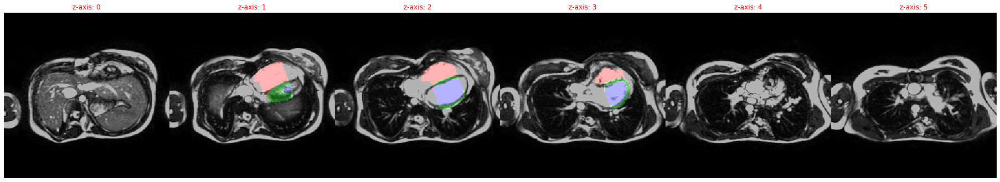

2020-07-15 13:11:43,220 INFO GT on AX


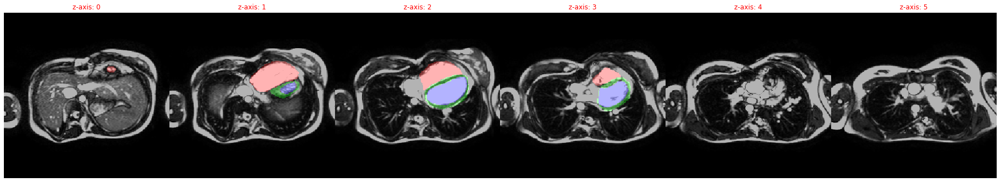

2020-07-15 13:11:43,639 INFO MSE: 0.03871407359838486
2020-07-15 13:11:43,640 INFO 0000-0HQQW4ZN_2007-05-23_ES_msk.nrrd
2020-07-15 13:11:43,640 INFO Prediction on AX volume:
2020-07-15 13:11:43,640 INFO AX --> SAX rotated by the model
2020-07-15 13:11:43,859 INFO Target (SAX):
2020-07-15 13:11:43,859 INFO Repeat the transformation on the full resolution
2020-07-15 13:11:44,752 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:11:45,591 INFO Predicted mask
2020-07-15 13:11:46,602 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:11:46,911 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:11:46,914 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:46,919 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:11:46,923 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:47,193 I

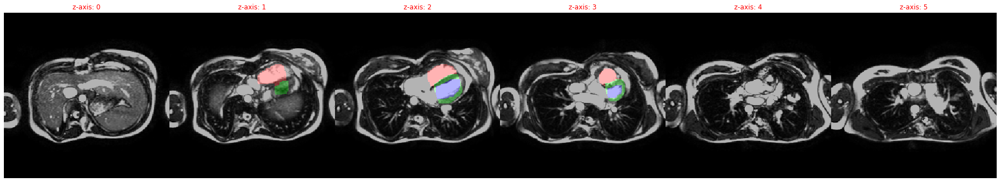

2020-07-15 13:11:47,609 INFO GT on AX


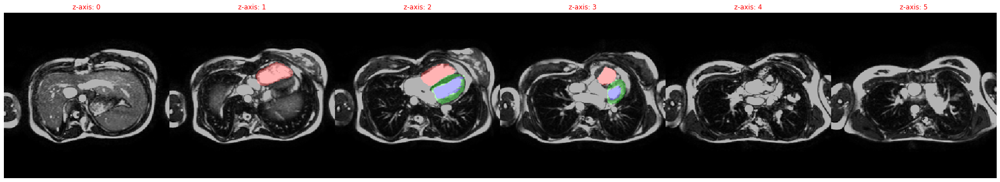

2020-07-15 13:11:48,018 INFO MSE: 0.03377380594611168
2020-07-15 13:11:48,019 INFO 0000-13JLP3HN_2007-05-22_ED_msk.nrrd
2020-07-15 13:11:48,020 INFO Prediction on AX volume:
2020-07-15 13:11:48,020 INFO AX --> SAX rotated by the model
2020-07-15 13:11:48,237 INFO Target (SAX):
2020-07-15 13:11:48,238 INFO Repeat the transformation on the full resolution
2020-07-15 13:11:49,133 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:11:49,984 INFO Predicted mask
2020-07-15 13:11:50,985 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:11:51,299 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:11:51,303 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:51,307 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:11:51,311 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:51,587 I

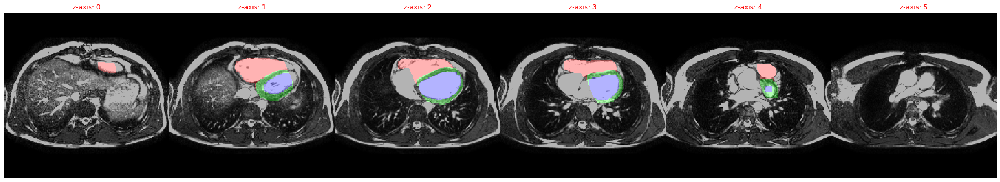

2020-07-15 13:11:52,003 INFO GT on AX


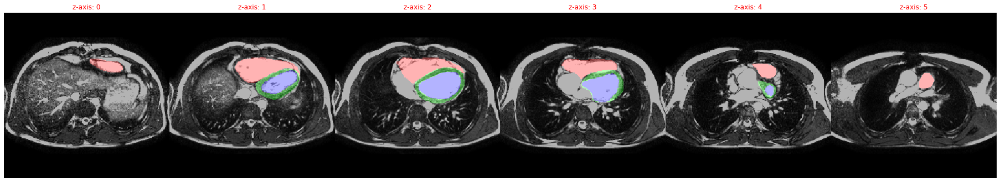

2020-07-15 13:11:52,423 INFO MSE: 0.055197905749082565
2020-07-15 13:11:52,424 INFO 0000-13JLP3HN_2007-05-22_ES_msk.nrrd
2020-07-15 13:11:52,424 INFO Prediction on AX volume:
2020-07-15 13:11:52,425 INFO AX --> SAX rotated by the model
2020-07-15 13:11:52,640 INFO Target (SAX):
2020-07-15 13:11:52,640 INFO Repeat the transformation on the full resolution
2020-07-15 13:11:53,534 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:11:54,382 INFO Predicted mask
2020-07-15 13:11:55,395 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:11:55,706 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:11:55,710 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:55,714 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:11:55,718 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:11:55,992 

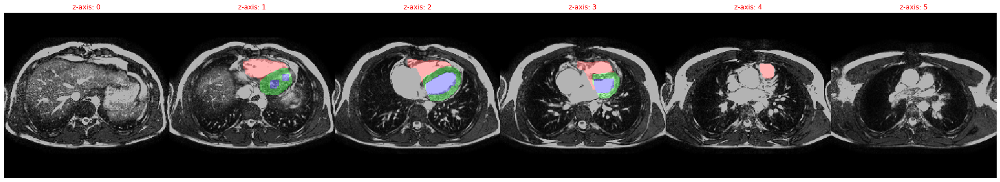

2020-07-15 13:11:56,414 INFO GT on AX


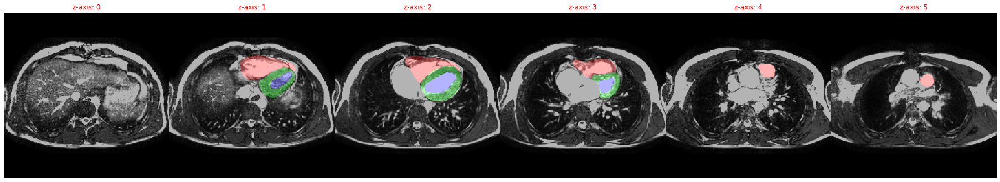

2020-07-15 13:11:56,836 INFO MSE: 0.049002647399902344
2020-07-15 13:11:56,836 INFO 0000-24YLF77L_2007-11-19_ED_msk.nrrd
2020-07-15 13:11:56,837 INFO Prediction on AX volume:
2020-07-15 13:11:56,837 INFO AX --> SAX rotated by the model
2020-07-15 13:11:57,056 INFO Target (SAX):
2020-07-15 13:11:57,056 INFO Repeat the transformation on the full resolution
2020-07-15 13:11:57,938 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:11:58,763 INFO Predicted mask
2020-07-15 13:11:59,757 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:00,070 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:00,073 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:00,077 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:00,081 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:00,356 

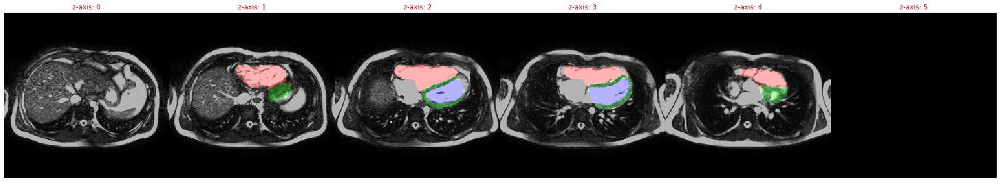

2020-07-15 13:12:00,763 INFO GT on AX


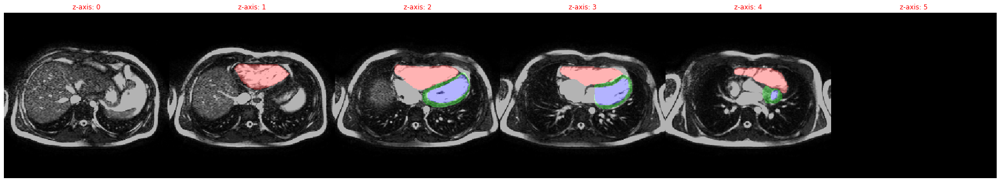

2020-07-15 13:12:01,175 INFO MSE: 0.04159405827522278
2020-07-15 13:12:01,176 INFO 0000-24YLF77L_2007-11-19_ES_msk.nrrd
2020-07-15 13:12:01,176 INFO Prediction on AX volume:
2020-07-15 13:12:01,176 INFO AX --> SAX rotated by the model
2020-07-15 13:12:01,387 INFO Target (SAX):
2020-07-15 13:12:01,387 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:02,277 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:03,157 INFO Predicted mask
2020-07-15 13:12:04,161 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:04,471 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:04,474 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:04,478 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:04,482 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:04,754 I

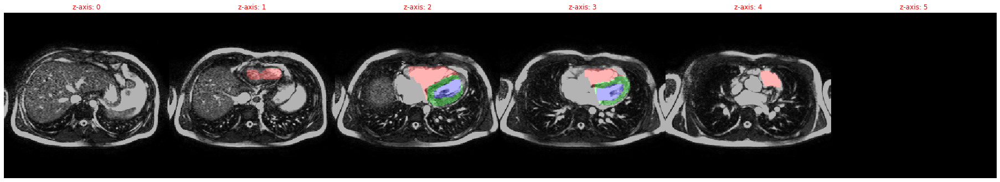

2020-07-15 13:12:05,149 INFO GT on AX


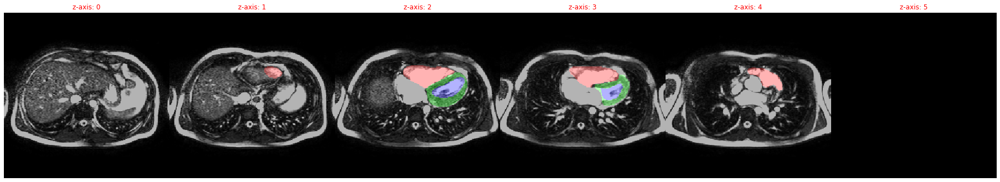

2020-07-15 13:12:05,546 INFO MSE: 0.03825186938047409
2020-07-15 13:12:05,546 INFO 0000-2CVUG1C5_2006-09-06_ED_msk.nrrd
2020-07-15 13:12:05,547 INFO Prediction on AX volume:
2020-07-15 13:12:05,547 INFO AX --> SAX rotated by the model
2020-07-15 13:12:05,764 INFO Target (SAX):
2020-07-15 13:12:05,764 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:06,660 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:07,508 INFO Predicted mask
2020-07-15 13:12:08,532 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:08,842 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:08,846 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:08,851 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:08,854 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:09,129 I

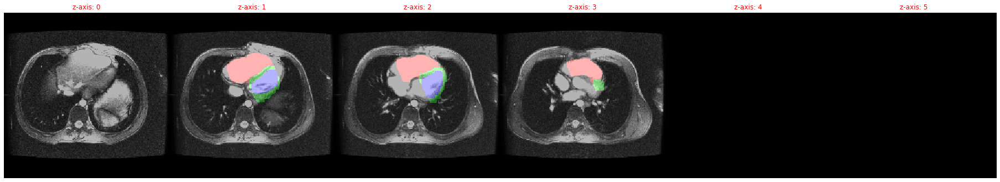

2020-07-15 13:12:09,524 INFO GT on AX


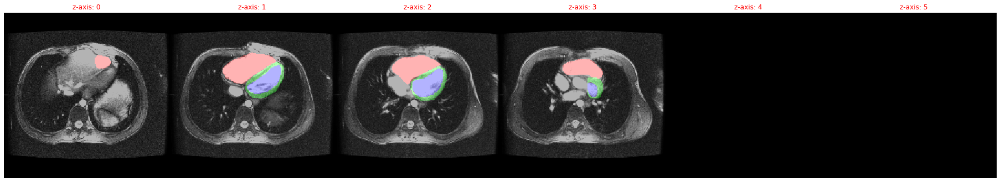

2020-07-15 13:12:09,924 INFO MSE: 0.029395604506134987
2020-07-15 13:12:09,925 INFO 0000-2CVUG1C5_2006-09-06_ES_msk.nrrd
2020-07-15 13:12:09,925 INFO Prediction on AX volume:
2020-07-15 13:12:09,925 INFO AX --> SAX rotated by the model
2020-07-15 13:12:10,138 INFO Target (SAX):
2020-07-15 13:12:10,139 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:11,031 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:11,898 INFO Predicted mask
2020-07-15 13:12:12,920 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:13,226 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:13,229 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:13,234 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:13,237 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:13,327 

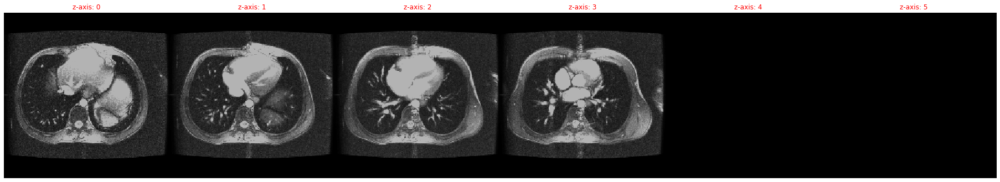

2020-07-15 13:12:13,731 INFO GT on AX


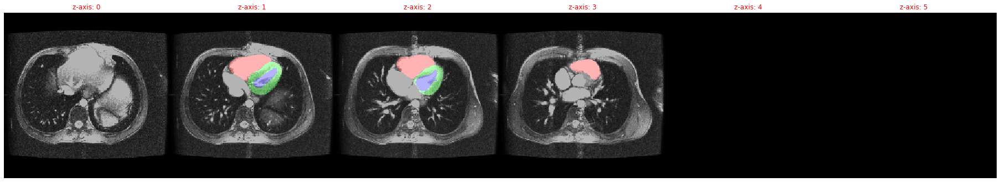

2020-07-15 13:12:14,131 INFO MSE: 0.030238373205065727
2020-07-15 13:12:14,131 INFO 0000-2CW0G1A5_2006-04-06_ED_msk.nrrd
2020-07-15 13:12:14,132 INFO Prediction on AX volume:
2020-07-15 13:12:14,132 INFO AX --> SAX rotated by the model
2020-07-15 13:12:14,348 INFO Target (SAX):
2020-07-15 13:12:14,348 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:17,964 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:18,873 INFO Predicted mask
2020-07-15 13:12:19,945 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:20,257 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:20,260 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:20,265 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:20,268 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:20,545 

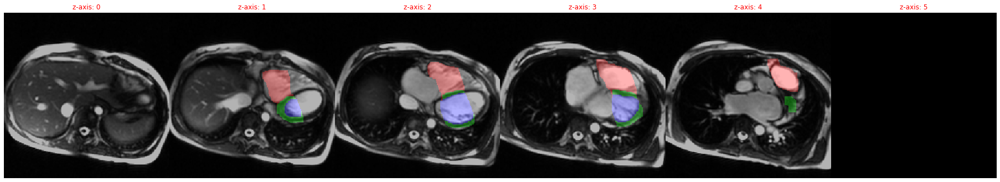

2020-07-15 13:12:20,969 INFO GT on AX


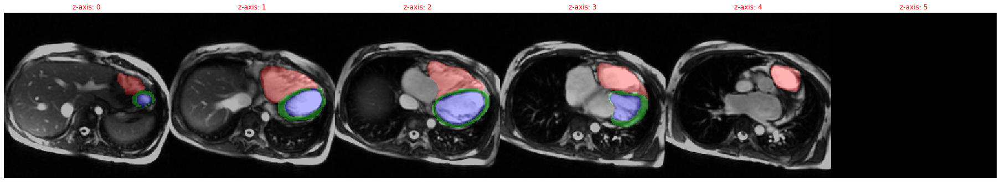

2020-07-15 13:12:21,396 INFO MSE: 0.026413774117827415
2020-07-15 13:12:21,396 INFO 0000-2CW0G1A5_2006-04-06_ES_msk.nrrd
2020-07-15 13:12:21,397 INFO Prediction on AX volume:
2020-07-15 13:12:21,397 INFO AX --> SAX rotated by the model
2020-07-15 13:12:21,612 INFO Target (SAX):
2020-07-15 13:12:21,613 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:22,544 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:23,362 INFO Predicted mask
2020-07-15 13:12:24,390 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:24,697 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:24,700 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:24,705 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:24,708 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:24,984 

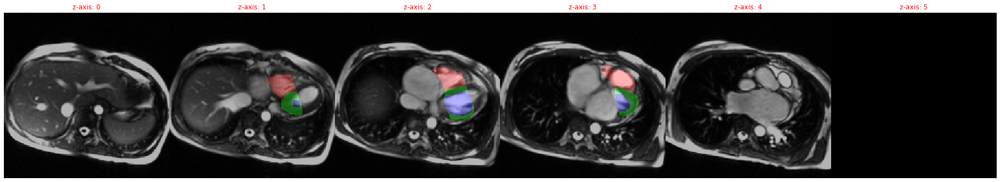

2020-07-15 13:12:25,411 INFO GT on AX


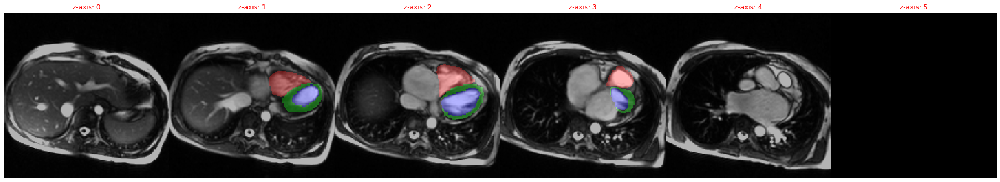

2020-07-15 13:12:25,828 INFO MSE: 0.024955233559012413
2020-07-15 13:12:25,829 INFO 0000-2XRR719Z_2005-05-02_ED_msk.nrrd
2020-07-15 13:12:25,829 INFO Prediction on AX volume:
2020-07-15 13:12:25,829 INFO AX --> SAX rotated by the model
2020-07-15 13:12:26,041 INFO Target (SAX):
2020-07-15 13:12:26,042 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:27,967 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:28,828 INFO Predicted mask
2020-07-15 13:12:29,826 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:30,132 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:30,135 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:30,140 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:30,144 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:30,417 

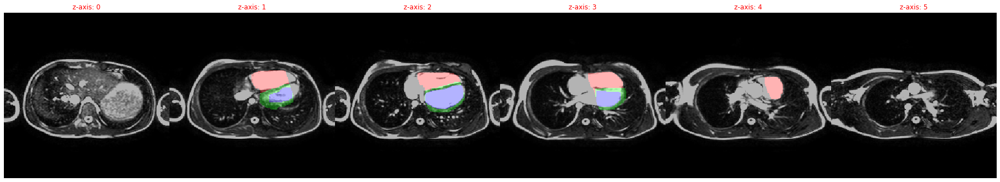

2020-07-15 13:12:30,813 INFO GT on AX


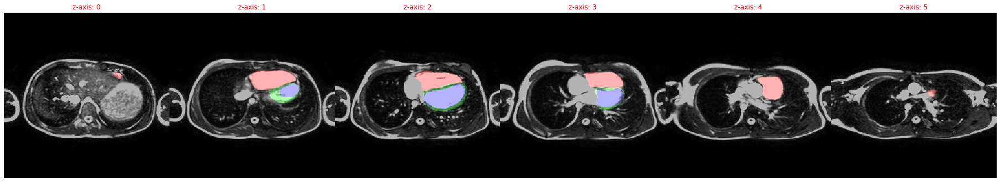

2020-07-15 13:12:31,214 INFO MSE: 0.03221586346626282
2020-07-15 13:12:31,214 INFO 0000-2XRR719Z_2005-05-02_ES_msk.nrrd
2020-07-15 13:12:31,215 INFO Prediction on AX volume:
2020-07-15 13:12:31,215 INFO AX --> SAX rotated by the model
2020-07-15 13:12:31,428 INFO Target (SAX):
2020-07-15 13:12:31,428 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:32,308 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:33,143 INFO Predicted mask
2020-07-15 13:12:35,184 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:35,491 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:35,494 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:35,498 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:35,502 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:35,773 I

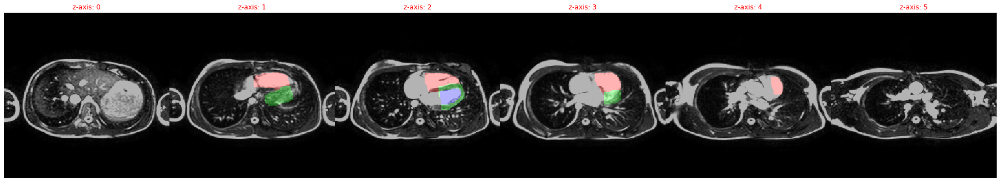

2020-07-15 13:12:36,176 INFO GT on AX


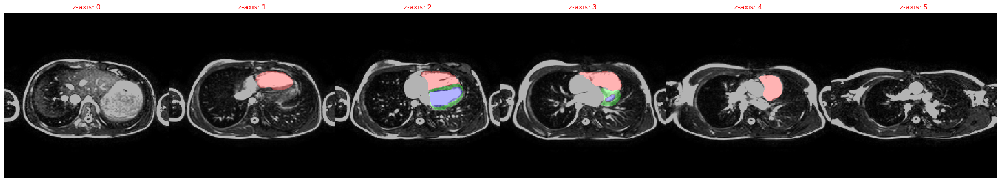

2020-07-15 13:12:36,582 INFO MSE: 0.030960561707615852
2020-07-15 13:12:36,583 INFO 0000-3EX293QC_2006-06-19_ED_msk.nrrd
2020-07-15 13:12:36,583 INFO Prediction on AX volume:
2020-07-15 13:12:36,583 INFO AX --> SAX rotated by the model
2020-07-15 13:12:36,796 INFO Target (SAX):
2020-07-15 13:12:36,797 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:37,690 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:38,532 INFO Predicted mask
2020-07-15 13:12:39,540 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:39,853 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:39,856 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:39,860 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:39,864 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:40,142 

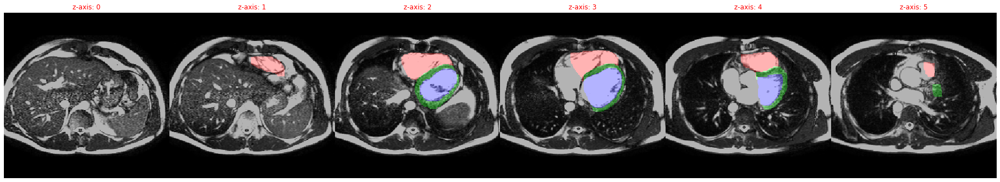

2020-07-15 13:12:40,564 INFO GT on AX


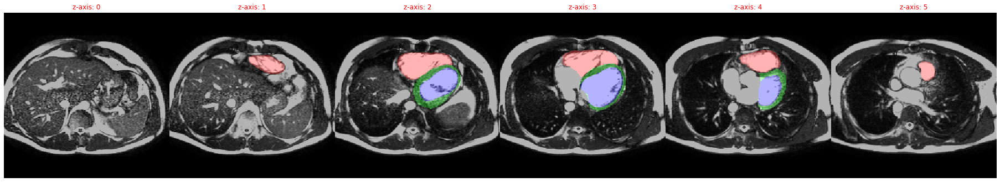

2020-07-15 13:12:40,992 INFO MSE: 0.0643414780497551
2020-07-15 13:12:40,993 INFO 0000-3EX293QC_2006-06-19_ES_msk.nrrd
2020-07-15 13:12:40,993 INFO Prediction on AX volume:
2020-07-15 13:12:40,993 INFO AX --> SAX rotated by the model
2020-07-15 13:12:41,207 INFO Target (SAX):
2020-07-15 13:12:41,207 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:42,096 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:42,941 INFO Predicted mask
2020-07-15 13:12:43,962 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:44,271 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:44,275 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:44,279 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:44,283 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:44,559 IN

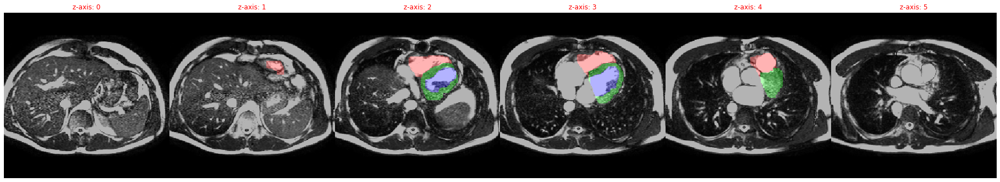

2020-07-15 13:12:44,983 INFO GT on AX


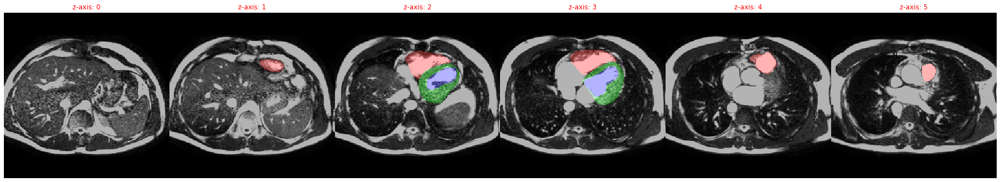

2020-07-15 13:12:45,407 INFO MSE: 0.06190619617700577
2020-07-15 13:12:45,408 INFO 0000-5RMHZGWP_2006-08-03_ED_msk.nrrd
2020-07-15 13:12:45,408 INFO Prediction on AX volume:
2020-07-15 13:12:45,408 INFO AX --> SAX rotated by the model
2020-07-15 13:12:45,622 INFO Target (SAX):
2020-07-15 13:12:45,622 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:46,503 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:47,354 INFO Predicted mask
2020-07-15 13:12:49,352 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:49,666 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:49,670 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:49,674 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:49,678 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:49,950 I

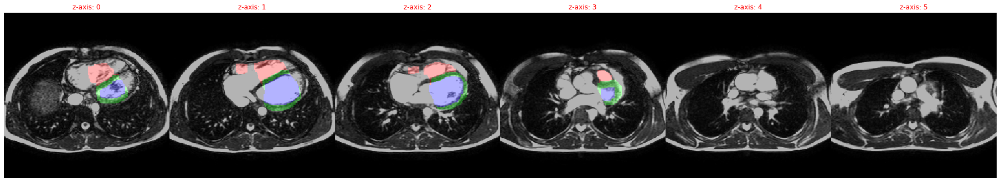

2020-07-15 13:12:50,358 INFO GT on AX


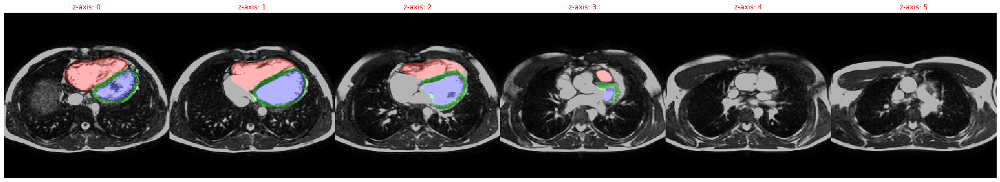

2020-07-15 13:12:50,773 INFO MSE: 0.04069788381457329
2020-07-15 13:12:50,774 INFO 0000-5RMHZGWP_2006-08-03_ES_msk.nrrd
2020-07-15 13:12:50,774 INFO Prediction on AX volume:
2020-07-15 13:12:50,774 INFO AX --> SAX rotated by the model
2020-07-15 13:12:50,980 INFO Target (SAX):
2020-07-15 13:12:50,981 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:51,867 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:52,713 INFO Predicted mask
2020-07-15 13:12:54,709 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:55,017 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:55,020 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:55,025 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:55,028 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:55,300 I

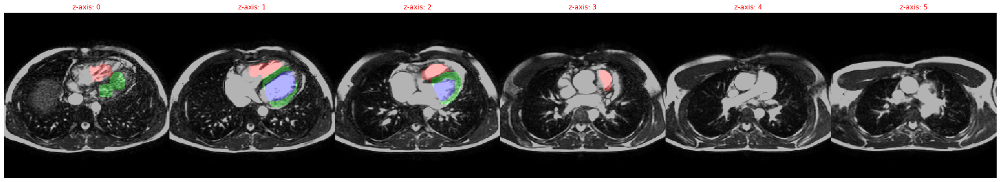

2020-07-15 13:12:55,713 INFO GT on AX


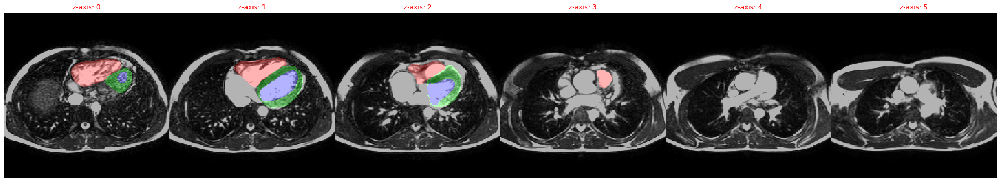

2020-07-15 13:12:56,125 INFO MSE: 0.03961605578660965
2020-07-15 13:12:56,125 INFO 0000-5W8RFCJD_2005-04-18_ED_msk.nrrd
2020-07-15 13:12:56,125 INFO Prediction on AX volume:
2020-07-15 13:12:56,126 INFO AX --> SAX rotated by the model
2020-07-15 13:12:56,338 INFO Target (SAX):
2020-07-15 13:12:56,338 INFO Repeat the transformation on the full resolution
2020-07-15 13:12:57,218 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:12:58,083 INFO Predicted mask
2020-07-15 13:12:59,086 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:12:59,395 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:12:59,398 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:59,403 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:12:59,406 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:12:59,680 I

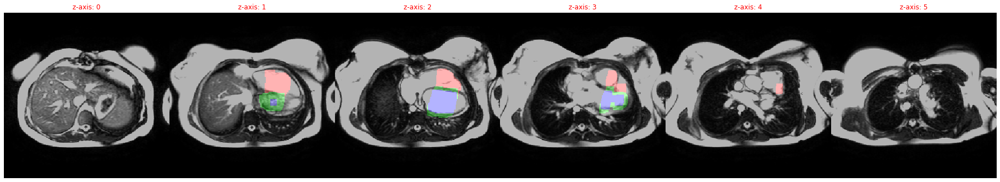

2020-07-15 13:13:00,084 INFO GT on AX


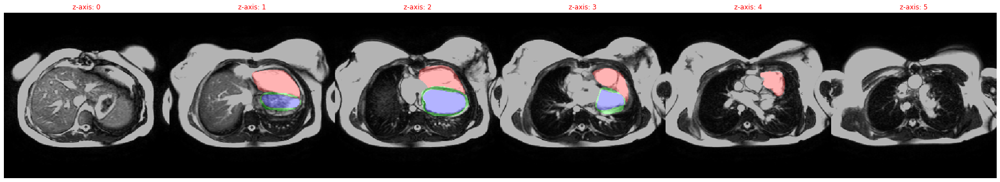

2020-07-15 13:13:00,491 INFO MSE: 0.1023697480559349
2020-07-15 13:13:00,492 INFO 0000-5W8RFCJD_2005-04-18_ES_msk.nrrd
2020-07-15 13:13:00,492 INFO Prediction on AX volume:
2020-07-15 13:13:00,493 INFO AX --> SAX rotated by the model
2020-07-15 13:13:00,705 INFO Target (SAX):
2020-07-15 13:13:00,706 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:01,603 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:02,472 INFO Predicted mask
2020-07-15 13:13:03,476 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:03,781 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:03,784 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:03,788 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:03,792 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:03,882 IN

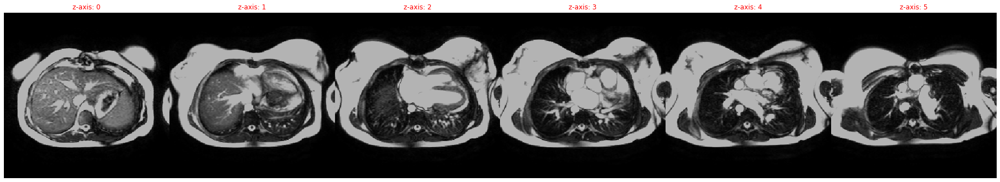

2020-07-15 13:13:04,303 INFO GT on AX


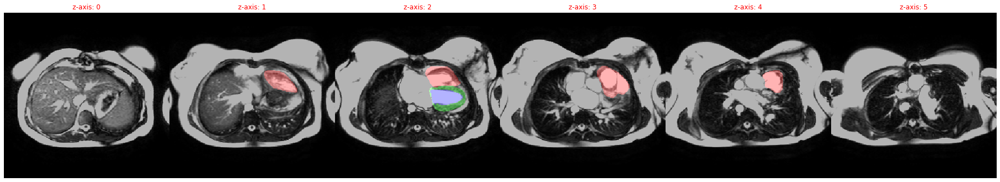

2020-07-15 13:13:04,719 INFO MSE: 0.10128504037857056
2020-07-15 13:13:04,720 INFO 0000-DLTVKE94_2006-07-18_ED_msk.nrrd
2020-07-15 13:13:04,720 INFO Prediction on AX volume:
2020-07-15 13:13:04,720 INFO AX --> SAX rotated by the model
2020-07-15 13:13:04,934 INFO Target (SAX):
2020-07-15 13:13:04,934 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:05,828 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:06,654 INFO Predicted mask
2020-07-15 13:13:07,642 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:07,957 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:07,961 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:07,968 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:07,972 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:08,248 I

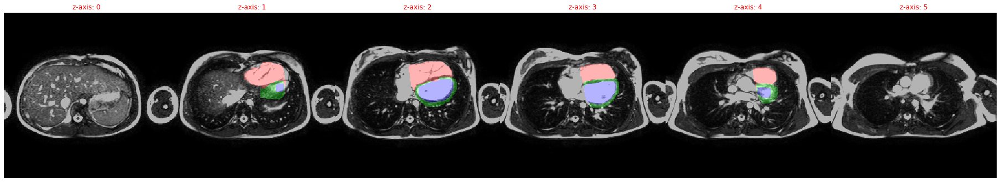

2020-07-15 13:13:08,647 INFO GT on AX


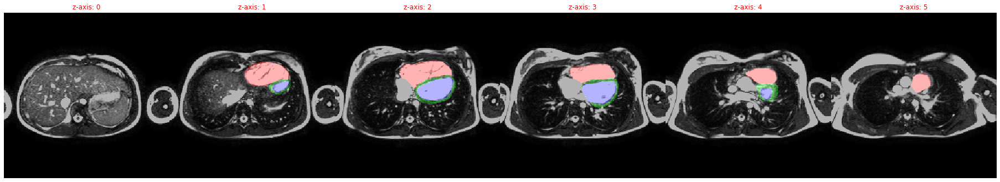

2020-07-15 13:13:09,046 INFO MSE: 0.04551883414387703
2020-07-15 13:13:09,047 INFO 0000-DLTVKE94_2006-07-18_ES_msk.nrrd
2020-07-15 13:13:09,047 INFO Prediction on AX volume:
2020-07-15 13:13:09,047 INFO AX --> SAX rotated by the model
2020-07-15 13:13:09,255 INFO Target (SAX):
2020-07-15 13:13:09,256 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:10,135 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:10,972 INFO Predicted mask
2020-07-15 13:13:11,965 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:12,270 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:12,273 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:12,277 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:12,281 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:12,564 I

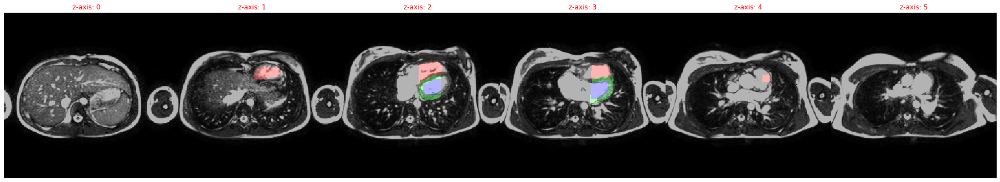

2020-07-15 13:13:12,959 INFO GT on AX


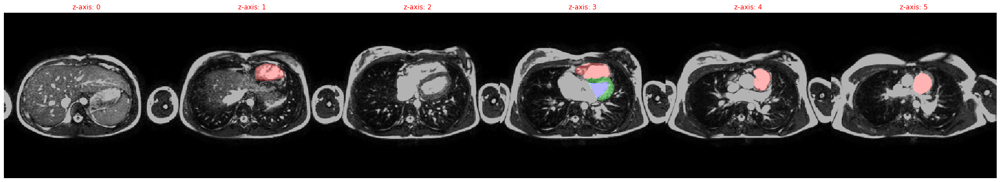

2020-07-15 13:13:13,361 INFO MSE: 0.043931860476732254
2020-07-15 13:13:13,361 INFO 0000-E0RJZQQM_2005-09-30_ED_msk.nrrd
2020-07-15 13:13:13,361 INFO Prediction on AX volume:
2020-07-15 13:13:13,362 INFO AX --> SAX rotated by the model
2020-07-15 13:13:13,574 INFO Target (SAX):
2020-07-15 13:13:13,574 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:14,457 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:15,319 INFO Predicted mask
2020-07-15 13:13:16,311 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:16,625 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:16,628 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:16,633 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:16,636 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:16,918 

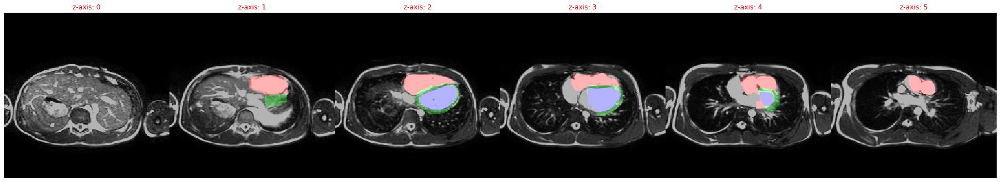

2020-07-15 13:13:17,321 INFO GT on AX


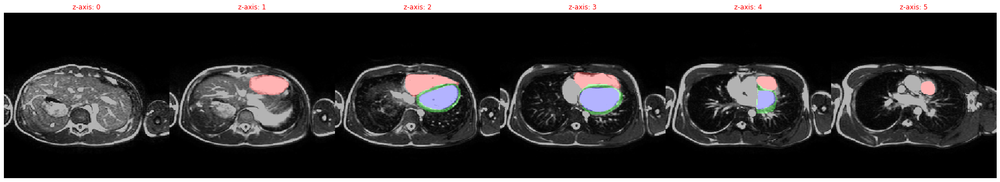

2020-07-15 13:13:17,724 INFO MSE: 0.029125288128852844
2020-07-15 13:13:17,725 INFO 0000-E0RJZQQM_2005-09-30_ES_msk.nrrd
2020-07-15 13:13:17,725 INFO Prediction on AX volume:
2020-07-15 13:13:17,726 INFO AX --> SAX rotated by the model
2020-07-15 13:13:17,938 INFO Target (SAX):
2020-07-15 13:13:17,939 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:19,866 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:20,777 INFO Predicted mask
2020-07-15 13:13:21,771 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:22,084 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:22,087 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:22,091 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:22,095 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:22,367 

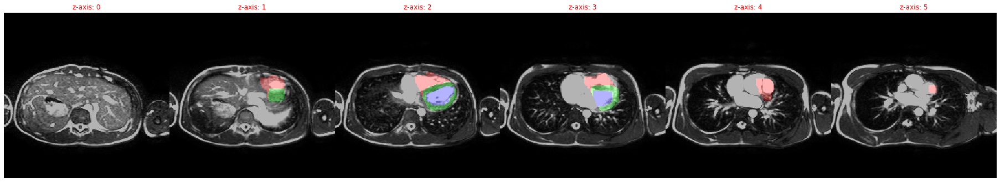

2020-07-15 13:13:22,771 INFO GT on AX


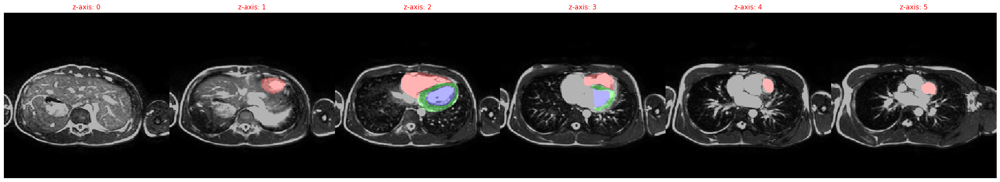

2020-07-15 13:13:23,174 INFO MSE: 0.026414228603243828
2020-07-15 13:13:23,175 INFO 0000-E24LRCWD_2006-11-23_ED_msk.nrrd
2020-07-15 13:13:23,175 INFO Prediction on AX volume:
2020-07-15 13:13:23,176 INFO AX --> SAX rotated by the model
2020-07-15 13:13:23,391 INFO Target (SAX):
2020-07-15 13:13:23,392 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:24,295 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:25,149 INFO Predicted mask
2020-07-15 13:13:26,147 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:26,461 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:26,464 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:26,469 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:26,472 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:26,749 

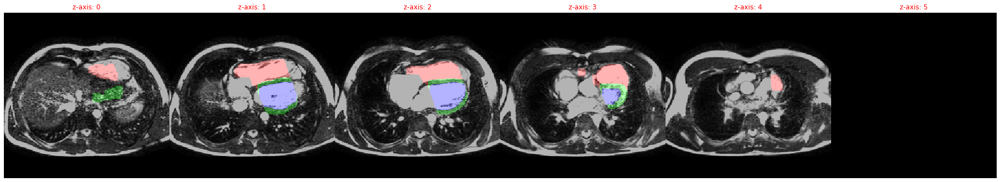

2020-07-15 13:13:27,154 INFO GT on AX


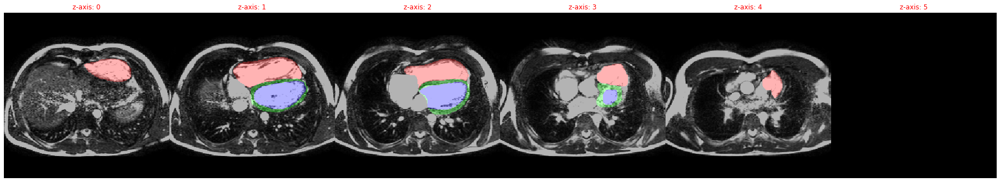

2020-07-15 13:13:27,563 INFO MSE: 0.048614516854286194
2020-07-15 13:13:27,564 INFO 0000-E24LRCWD_2006-11-23_ES_msk.nrrd
2020-07-15 13:13:27,564 INFO Prediction on AX volume:
2020-07-15 13:13:27,564 INFO AX --> SAX rotated by the model
2020-07-15 13:13:27,778 INFO Target (SAX):
2020-07-15 13:13:27,778 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:28,659 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:29,531 INFO Predicted mask
2020-07-15 13:13:30,533 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:30,845 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:30,848 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:30,853 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:30,856 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:31,129 

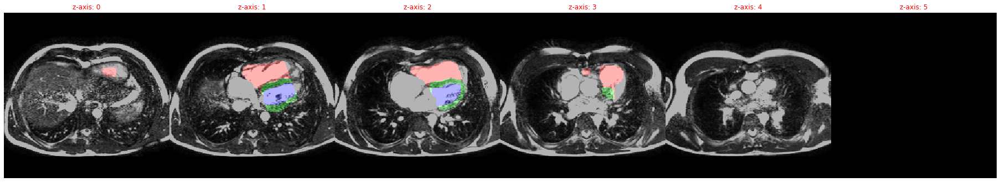

2020-07-15 13:13:31,527 INFO GT on AX


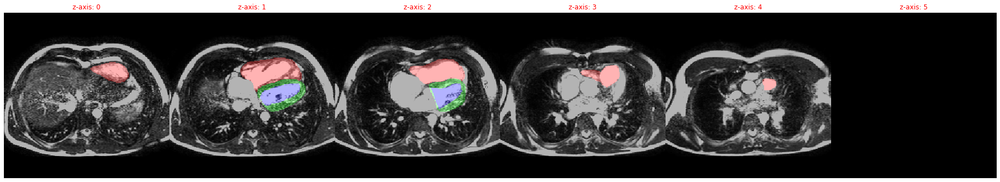

2020-07-15 13:13:31,929 INFO MSE: 0.04745042696595192
2020-07-15 13:13:31,930 INFO 0000-FANDNZ55_2007-02-19_ED_msk.nrrd
2020-07-15 13:13:31,930 INFO Prediction on AX volume:
2020-07-15 13:13:31,930 INFO AX --> SAX rotated by the model
2020-07-15 13:13:32,140 INFO Target (SAX):
2020-07-15 13:13:32,141 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:33,030 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:33,873 INFO Predicted mask
2020-07-15 13:13:34,883 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:35,211 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:35,214 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:35,218 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:35,221 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:35,511 I

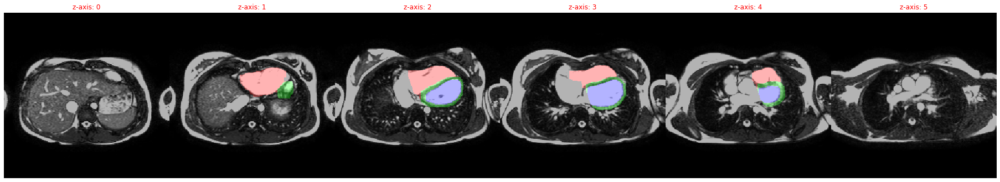

2020-07-15 13:13:35,930 INFO GT on AX


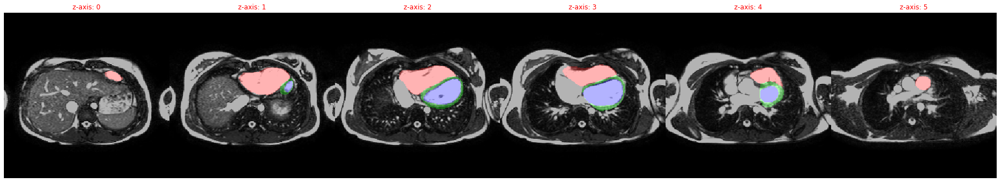

2020-07-15 13:13:36,347 INFO MSE: 0.049594949930906296
2020-07-15 13:13:36,348 INFO 0000-FANDNZ55_2007-02-19_ES_msk.nrrd
2020-07-15 13:13:36,348 INFO Prediction on AX volume:
2020-07-15 13:13:36,348 INFO AX --> SAX rotated by the model
2020-07-15 13:13:36,558 INFO Target (SAX):
2020-07-15 13:13:36,559 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:37,453 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:38,305 INFO Predicted mask
2020-07-15 13:13:39,309 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:39,618 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:39,621 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:39,625 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:39,629 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:39,900 

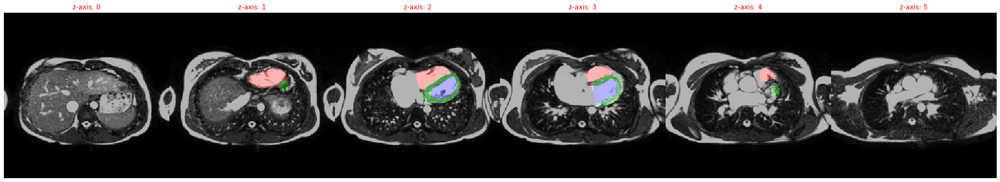

2020-07-15 13:13:40,304 INFO GT on AX


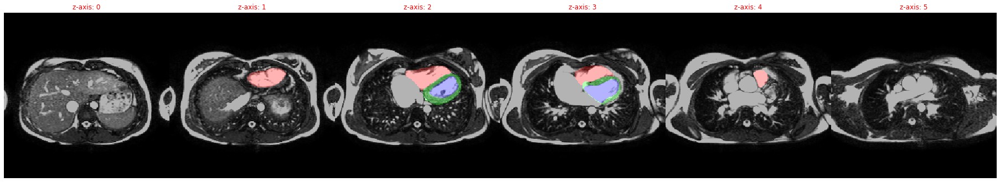

2020-07-15 13:13:40,713 INFO MSE: 0.04688219353556633
2020-07-15 13:13:40,713 INFO 0000-FHQU30DQ_2005-05-10_ED_msk.nrrd
2020-07-15 13:13:40,713 INFO Prediction on AX volume:
2020-07-15 13:13:40,714 INFO AX --> SAX rotated by the model
2020-07-15 13:13:40,930 INFO Target (SAX):
2020-07-15 13:13:40,931 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:41,810 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:42,653 INFO Predicted mask
2020-07-15 13:13:43,657 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:43,969 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:43,973 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:43,977 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:43,981 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:44,257 I

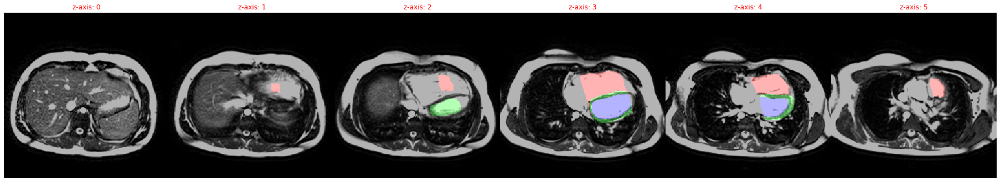

2020-07-15 13:13:44,662 INFO GT on AX


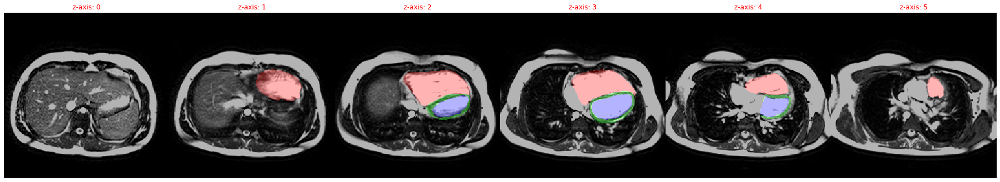

2020-07-15 13:13:45,070 INFO MSE: 0.04225028306245804
2020-07-15 13:13:45,071 INFO 0000-FHQU30DQ_2005-05-10_ES_msk.nrrd
2020-07-15 13:13:45,071 INFO Prediction on AX volume:
2020-07-15 13:13:45,071 INFO AX --> SAX rotated by the model
2020-07-15 13:13:45,288 INFO Target (SAX):
2020-07-15 13:13:45,288 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:46,183 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:47,014 INFO Predicted mask
2020-07-15 13:13:48,015 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:48,324 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:48,328 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:48,332 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:48,335 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:48,605 I

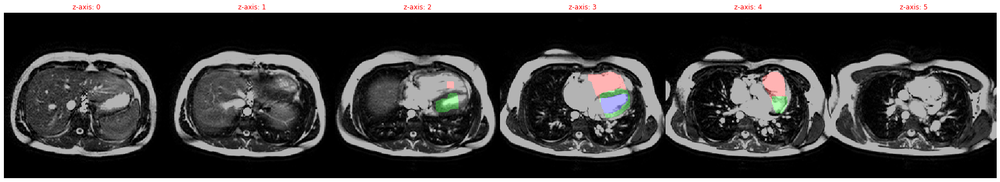

2020-07-15 13:13:49,011 INFO GT on AX


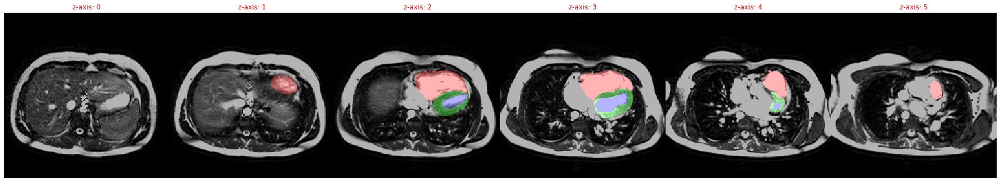

2020-07-15 13:13:49,421 INFO MSE: 0.04181003198027611
2020-07-15 13:13:49,422 INFO 0000-G8XJ03CH_2007-10-31_ED_msk.nrrd
2020-07-15 13:13:49,422 INFO Prediction on AX volume:
2020-07-15 13:13:49,423 INFO AX --> SAX rotated by the model
2020-07-15 13:13:49,630 INFO Target (SAX):
2020-07-15 13:13:49,630 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:50,523 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:51,389 INFO Predicted mask
2020-07-15 13:13:52,413 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:52,725 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:52,728 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:52,732 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:52,736 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:53,008 I

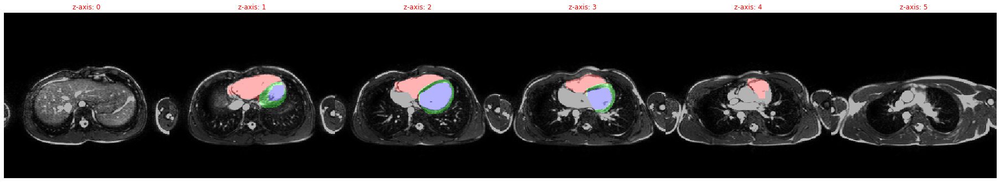

2020-07-15 13:13:53,402 INFO GT on AX


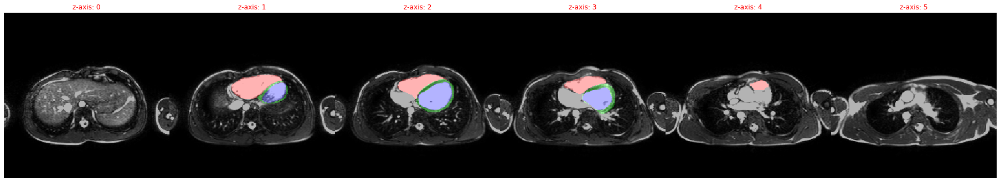

2020-07-15 13:13:53,797 INFO MSE: 0.02128996141254902
2020-07-15 13:13:53,798 INFO 0000-G8XJ03CH_2007-10-31_ES_msk.nrrd
2020-07-15 13:13:53,798 INFO Prediction on AX volume:
2020-07-15 13:13:53,799 INFO AX --> SAX rotated by the model
2020-07-15 13:13:54,014 INFO Target (SAX):
2020-07-15 13:13:54,014 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:54,911 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:13:55,762 INFO Predicted mask
2020-07-15 13:13:56,783 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:13:57,095 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:13:57,098 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:57,103 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:13:57,106 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:13:57,379 I

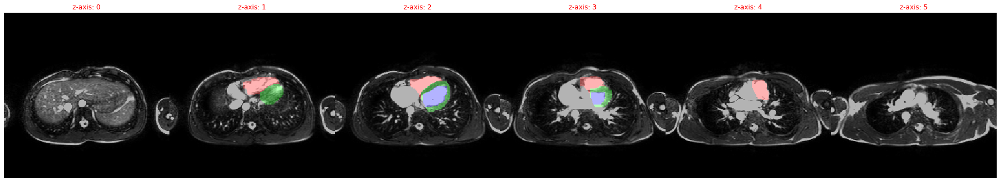

2020-07-15 13:13:57,777 INFO GT on AX


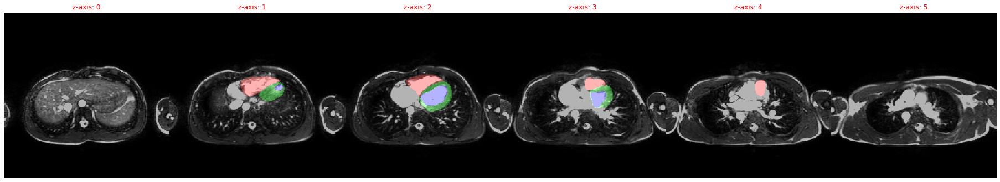

2020-07-15 13:13:58,179 INFO MSE: 0.01978515461087227
2020-07-15 13:13:58,180 INFO 0000-GYMP57R6_2006-12-18_ED_msk.nrrd
2020-07-15 13:13:58,181 INFO Prediction on AX volume:
2020-07-15 13:13:58,181 INFO AX --> SAX rotated by the model
2020-07-15 13:13:58,396 INFO Target (SAX):
2020-07-15 13:13:58,397 INFO Repeat the transformation on the full resolution
2020-07-15 13:13:59,279 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:00,118 INFO Predicted mask
2020-07-15 13:14:01,135 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:01,455 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:01,458 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:01,463 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:01,466 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:01,746 I

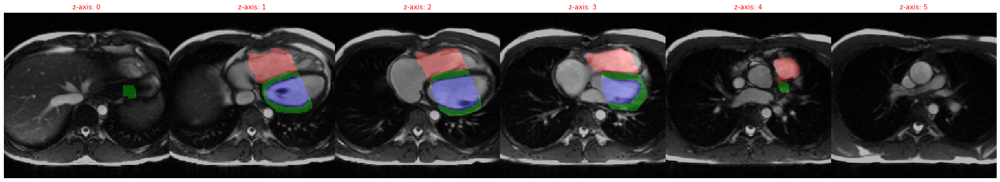

2020-07-15 13:14:02,186 INFO GT on AX


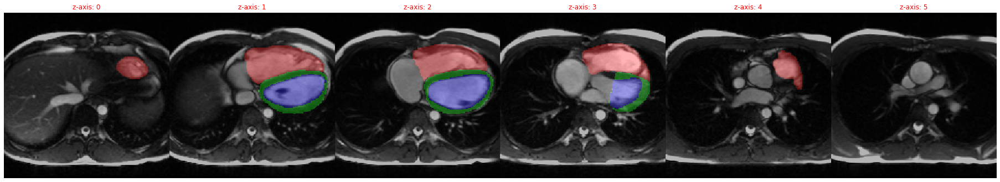

2020-07-15 13:14:04,503 INFO MSE: 0.0250757597386837
2020-07-15 13:14:04,504 INFO 0000-GYMP57R6_2006-12-18_ES_msk.nrrd
2020-07-15 13:14:04,504 INFO Prediction on AX volume:
2020-07-15 13:14:04,505 INFO AX --> SAX rotated by the model
2020-07-15 13:14:04,731 INFO Target (SAX):
2020-07-15 13:14:04,731 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:05,761 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:06,614 INFO Predicted mask
2020-07-15 13:14:07,702 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:08,015 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:08,019 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:08,024 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:08,027 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:08,306 IN

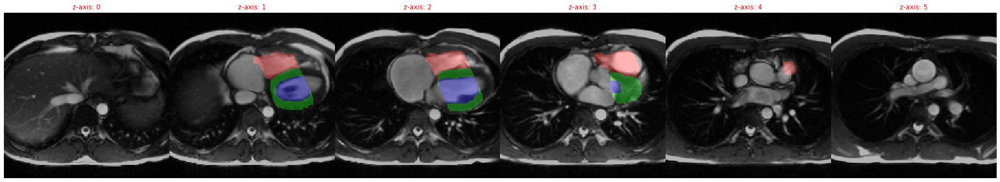

2020-07-15 13:14:08,746 INFO GT on AX


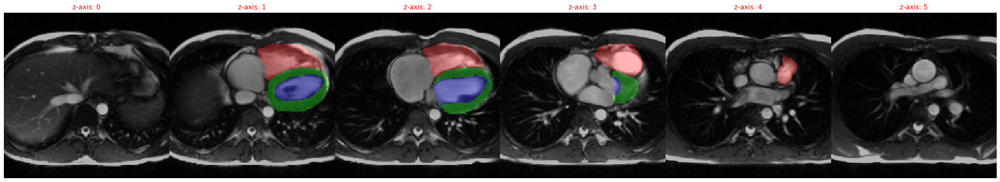

2020-07-15 13:14:09,185 INFO MSE: 0.02578573115170002
2020-07-15 13:14:09,186 INFO 0000-GYRF6ZAA_2004-08-01_ED_msk.nrrd
2020-07-15 13:14:09,186 INFO Prediction on AX volume:
2020-07-15 13:14:09,186 INFO AX --> SAX rotated by the model
2020-07-15 13:14:09,408 INFO Target (SAX):
2020-07-15 13:14:09,408 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:11,377 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:12,240 INFO Predicted mask
2020-07-15 13:14:13,291 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:13,597 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:13,600 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:13,605 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:13,609 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:13,900 I

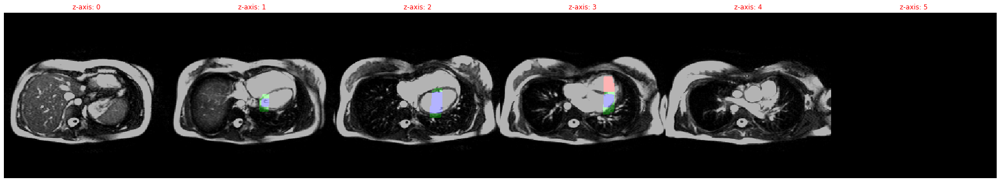

2020-07-15 13:14:14,284 INFO GT on AX


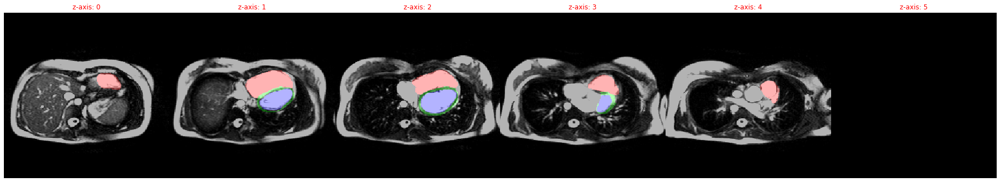

2020-07-15 13:14:14,674 INFO MSE: 0.05016723647713661
2020-07-15 13:14:14,675 INFO 0000-GYRF6ZAA_2004-08-01_ES_msk.nrrd
2020-07-15 13:14:14,675 INFO Prediction on AX volume:
2020-07-15 13:14:14,675 INFO AX --> SAX rotated by the model
2020-07-15 13:14:14,891 INFO Target (SAX):
2020-07-15 13:14:14,891 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:15,820 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:16,666 INFO Predicted mask
2020-07-15 13:14:17,699 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:18,007 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:18,010 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:18,015 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:18,019 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:18,289 I

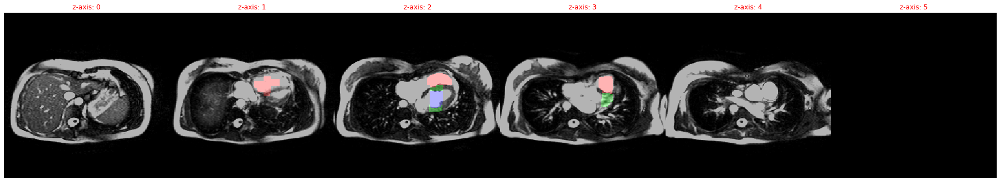

2020-07-15 13:14:18,672 INFO GT on AX


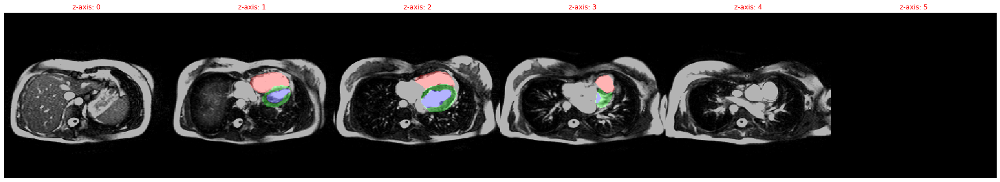

2020-07-15 13:14:19,060 INFO MSE: 0.045057762414216995
2020-07-15 13:14:19,061 INFO 0000-JDRPF7F4_2006-02-28_ED_msk.nrrd
2020-07-15 13:14:19,061 INFO Prediction on AX volume:
2020-07-15 13:14:19,061 INFO AX --> SAX rotated by the model
2020-07-15 13:14:19,274 INFO Target (SAX):
2020-07-15 13:14:19,275 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:21,193 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:22,057 INFO Predicted mask
2020-07-15 13:14:23,066 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:23,381 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:23,386 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:23,391 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:23,396 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:23,683 

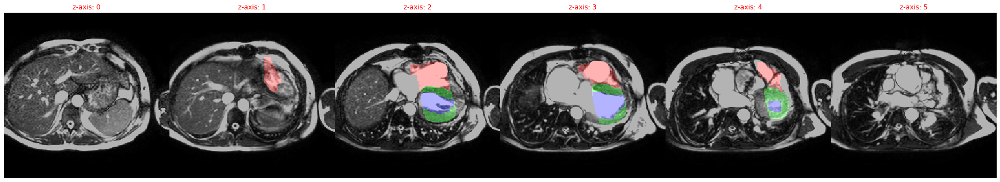

2020-07-15 13:14:24,110 INFO GT on AX


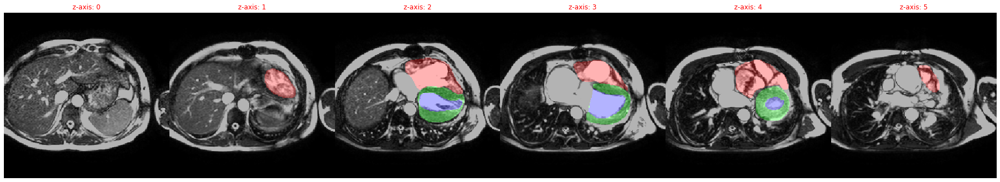

2020-07-15 13:14:24,540 INFO MSE: 0.04338833689689636
2020-07-15 13:14:24,541 INFO 0000-JDRPF7F4_2006-02-28_ES_msk.nrrd
2020-07-15 13:14:24,541 INFO Prediction on AX volume:
2020-07-15 13:14:24,541 INFO AX --> SAX rotated by the model
2020-07-15 13:14:24,757 INFO Target (SAX):
2020-07-15 13:14:24,758 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:25,666 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:26,545 INFO Predicted mask
2020-07-15 13:14:27,559 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:27,875 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:27,879 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:27,883 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:27,887 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:28,165 I

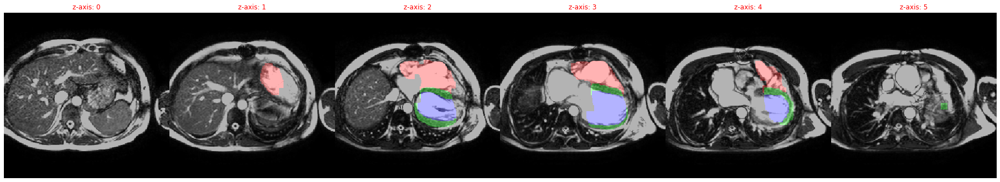

2020-07-15 13:14:28,583 INFO GT on AX


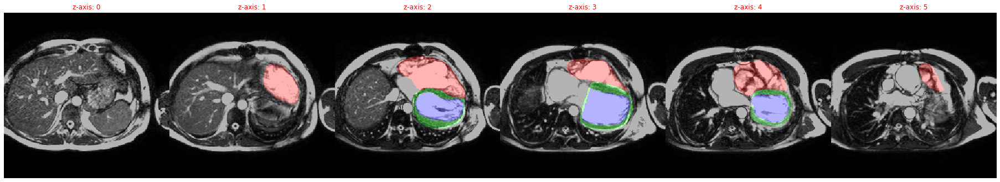

2020-07-15 13:14:29,006 INFO MSE: 0.04502391815185547
2020-07-15 13:14:29,007 INFO 0000-JP6XAZWH_2007-03-02_ED_msk.nrrd
2020-07-15 13:14:29,007 INFO Prediction on AX volume:
2020-07-15 13:14:29,007 INFO AX --> SAX rotated by the model
2020-07-15 13:14:29,216 INFO Target (SAX):
2020-07-15 13:14:29,217 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:31,107 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:31,965 INFO Predicted mask
2020-07-15 13:14:32,978 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:33,288 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:33,292 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:33,297 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:33,300 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:33,578 I

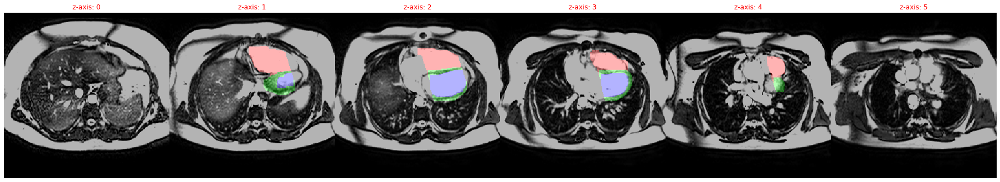

2020-07-15 13:14:33,993 INFO GT on AX


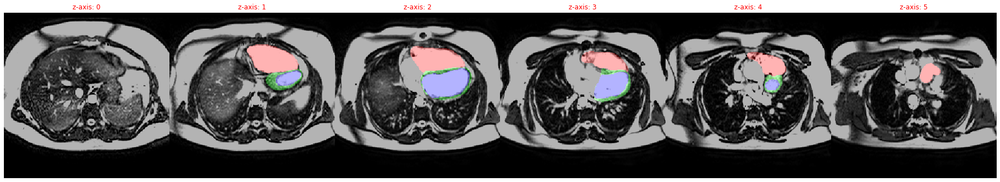

2020-07-15 13:14:34,409 INFO MSE: 0.11341911554336548
2020-07-15 13:14:34,410 INFO 0000-JP6XAZWH_2007-03-02_ES_msk.nrrd
2020-07-15 13:14:34,410 INFO Prediction on AX volume:
2020-07-15 13:14:34,411 INFO AX --> SAX rotated by the model
2020-07-15 13:14:34,624 INFO Target (SAX):
2020-07-15 13:14:34,624 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:35,514 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:36,356 INFO Predicted mask
2020-07-15 13:14:37,365 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:37,675 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:37,678 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:37,683 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:37,687 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:37,961 I

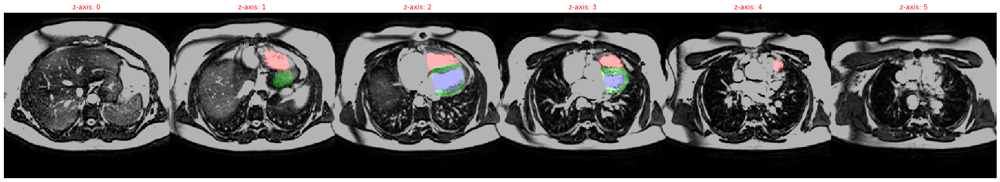

2020-07-15 13:14:38,379 INFO GT on AX


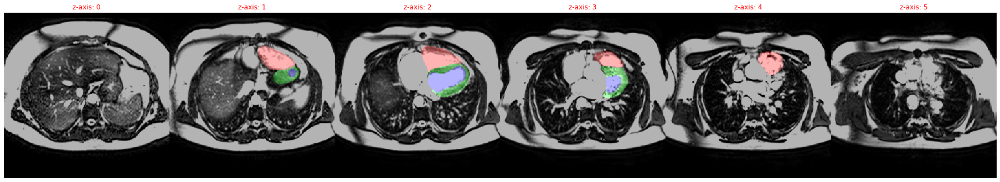

2020-07-15 13:14:38,803 INFO MSE: 0.10226208716630936
2020-07-15 13:14:38,803 INFO 0000-K4HCL72E_2007-03-27_ED_msk.nrrd
2020-07-15 13:14:38,803 INFO Prediction on AX volume:
2020-07-15 13:14:38,804 INFO AX --> SAX rotated by the model
2020-07-15 13:14:39,016 INFO Target (SAX):
2020-07-15 13:14:39,016 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:39,915 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:40,756 INFO Predicted mask
2020-07-15 13:14:41,760 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:42,071 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:42,074 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:42,078 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:42,082 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:42,357 I

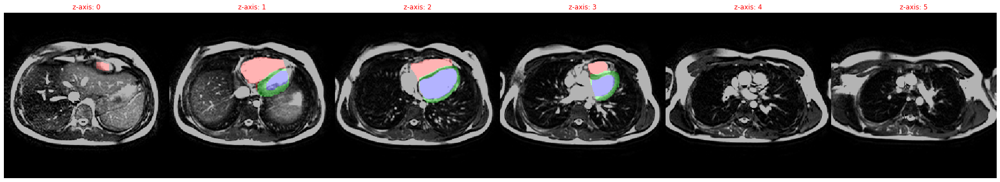

2020-07-15 13:14:42,767 INFO GT on AX


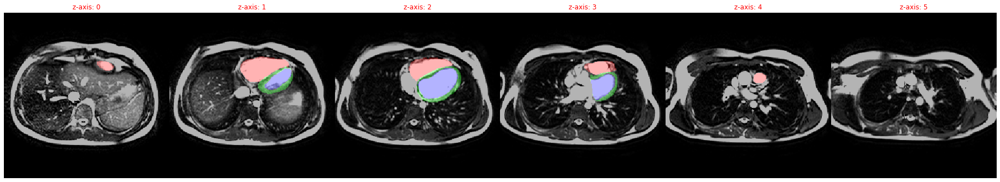

2020-07-15 13:14:43,178 INFO MSE: 0.05824046954512596
2020-07-15 13:14:43,179 INFO 0000-K4HCL72E_2007-03-27_ES_msk.nrrd
2020-07-15 13:14:43,179 INFO Prediction on AX volume:
2020-07-15 13:14:43,179 INFO AX --> SAX rotated by the model
2020-07-15 13:14:43,392 INFO Target (SAX):
2020-07-15 13:14:43,392 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:45,330 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:46,176 INFO Predicted mask
2020-07-15 13:14:47,171 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:47,479 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:47,482 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:47,487 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:47,490 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:47,764 I

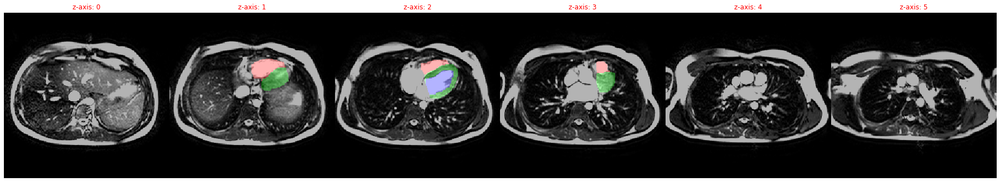

2020-07-15 13:14:48,173 INFO GT on AX


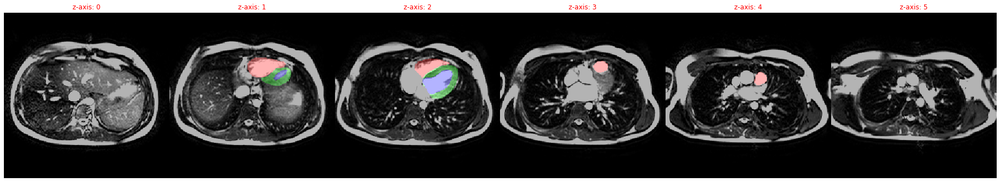

2020-07-15 13:14:48,585 INFO MSE: 0.052301324903964996
2020-07-15 13:14:48,586 INFO 0000-K61NJJ2D_2007-05-29_ED_msk.nrrd
2020-07-15 13:14:48,587 INFO Prediction on AX volume:
2020-07-15 13:14:48,587 INFO AX --> SAX rotated by the model
2020-07-15 13:14:48,800 INFO Target (SAX):
2020-07-15 13:14:48,800 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:49,679 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:50,557 INFO Predicted mask
2020-07-15 13:14:51,553 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:51,874 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:51,878 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:51,885 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:51,890 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:52,177 

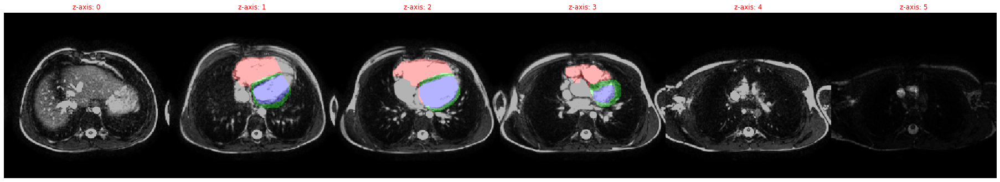

2020-07-15 13:14:52,613 INFO GT on AX


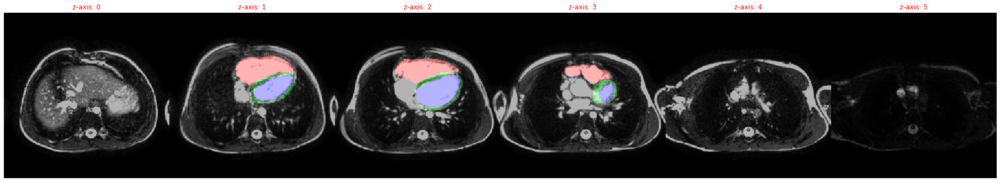

2020-07-15 13:14:53,029 INFO MSE: 0.028263840824365616
2020-07-15 13:14:53,030 INFO 0000-K61NJJ2D_2007-05-29_ES_msk.nrrd
2020-07-15 13:14:53,030 INFO Prediction on AX volume:
2020-07-15 13:14:53,031 INFO AX --> SAX rotated by the model
2020-07-15 13:14:53,245 INFO Target (SAX):
2020-07-15 13:14:53,246 INFO Repeat the transformation on the full resolution
2020-07-15 13:14:54,129 INFO Apply the invers rotation to our AXtoSAX
2020-07-15 13:14:55,018 INFO Predicted mask
2020-07-15 13:14:56,014 INFO Predicted mask rotated to AX on original AX image - before postprocessing
2020-07-15 13:14:56,327 INFO Predicted mask rotated to AX on original AX image - after connected component filtering
2020-07-15 13:14:56,330 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:56,335 INFO Predicted mask rotated to AX on original AX image - after opening
2020-07-15 13:14:56,338 INFO Predicted mask rotated to AX on original AX image - after closing
2020-07-15 13:14:56,617 

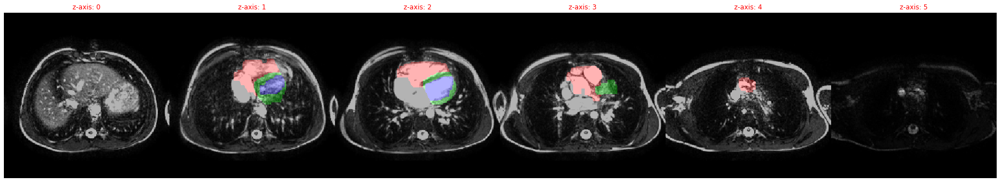

2020-07-15 13:14:57,046 INFO GT on AX


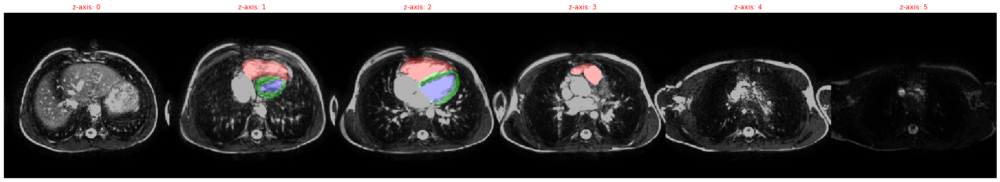

2020-07-15 13:14:57,470 INFO MSE: 0.02362825907766819


In [37]:
shift_z = 10
path_ = 'data/predicted/AX_to_SAX_to_AX_masked_unet_prob_finetune/3D/'
for i in range(x_.shape[0]):
    select_image_in_batch(im=i,slice_n=5, debug=False,shift_z=shift_z, export_path=path_, save=True)

In [ ]:
# check the memory usage
import sys

# These are the usual ipython objects, including this one you are creating
ipython_vars = ['In', 'Out', 'exit', 'quit', 'get_ipython', 'ipython_vars']

# Get a sorted list of the objects and their sizes
sorted([(x, sys.getsizeof(globals().get(x))) for x in dir() if not x.startswith('_') and x not in sys.modules and x not in ipython_vars], key=lambda x: x[1], reverse=True)


In [11]:
# Load a previous config and by this a pre-trained model
from ipyfilechooser import FileChooser
config_chooser = FileChooser(os.path.join(os.getcwd(),'reports/configs'), 'config.json')
display(config_chooser) # 3D/wrapper/fold1/last

FileChooser(path='/mnt/data/git/cardio/reports/configs', filename='config.json', show_hidden='False')

In [12]:
"""
load past config for model training 
"""
if 'strategy' in globals():
    pass
else:
    # distribute the training with the mirrored data paradigm across multiple gpus if available, if not use gpu 0
    strategy = tf.distribute.MirroredStrategy(devices=config.get('GPUS', ["/gpu:0"]))
tf.print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
if config_chooser:
    config_file  = config_chooser.selected
#config_file = 'reports/configs/2D/acdc/cv/fold3/2020-05-12_22_54/config.json'
load = True # change to false, if this pipeline is used without finetuning
# load config with all params into global namespace
from src.models.Unets import load_pretrained_model
if load: # load pretrained model
    with open(config_file, encoding='utf-8') as data_file:
        config_temp = json.loads(data_file.read())
    config_temp['LOSS_FUNCTION'] = config['LOSS_FUNCTION']
    logging.info('Load model from Experiment: {}'.format(config_temp['EXPERIMENT']))
    #logging.info('config:\n {}'.format(json.dumps(config, indent=4, sort_keys=True)))

    try:
        with strategy.scope():
            globals()['unet'] = load_pretrained_model(config_temp, metrics, comp=False,multigpu=False)
            #globals()['unet'].summary()
    except Exception as e:
        logging.error(str(e))

Number of devices: 2


2020-07-15 11:09:01,052 INFO Load model from Experiment: 3D/wrapper/gcn2nd/fold1
2020-07-15 11:09:01,052 INFO loading model from: models/3D/wrapper/gcn2nd/fold1/2020-06-27_11_24/model.json .
2020-07-15 11:09:32,768 INFO loading model description
2020-07-15 11:09:32,900 INFO loading model weights
2020-07-15 11:09:32,901 INFO model models/3D/wrapper/gcn2nd/fold1/2020-06-27_11_24/model.json loaded
